# Interpretability of pain behavior recognition

## First we need dataframes for every subject

In [1]:
from data_handler import DataHandler
import pandas as pd
import numpy as np
import os

# Data paths
rgb_path = 'data/jpg_128_128_2fps/'
of_path = 'data/jpg_128_128_16fps_OF_magnitude_cv2/'

# Hyperparameters
input_width = 128
input_height = 128
seq_length = 10
seq_stride = 10
batch_size = 1
COLOR = True
nb_labels = 2

# Data augmentation
aug_flip = 0
aug_crop = 0
aug_light = 0

subject_ids = pd.read_csv('horse_subjects.csv')['Subject'].values
channels = 3

Using TensorFlow backend.


In [2]:
class ArgsProxy:
    def __init__(self, data_path, of_path, input_height, input_width,
                 seq_length, seq_stride, batch_size, nb_labels,
                 aug_flip, aug_crop, aug_light):
        self.data_path = data_path
        self.of_path = of_path
        self.input_height = input_height
        self.input_width = input_width
        self.seq_length = seq_length
        self.seq_stride = seq_stride
        self.batch_size = batch_size
        self.nb_labels = nb_labels
        self.aug_flip = aug_flip
        self.aug_crop = aug_crop
        self.aug_light = aug_light

args = ArgsProxy(rgb_path, of_path, input_height, input_width,
                 seq_length, seq_stride, batch_size, nb_labels,
                 aug_flip, aug_crop, aug_light)

In [3]:
dh = DataHandler(path=args.data_path,
                 of_path=args.of_path,
                 clip_list_file='videos_overview_missingremoved.csv',
                 data_columns=['Pain'],  # Here one can append f. ex. 'Observer'
                 image_size=(args.input_height, args.input_width),
                 seq_length=args.seq_length,
                 seq_stride=args.seq_stride,
                 batch_size=args.batch_size,
                 color=COLOR,
                 nb_labels=args.nb_labels,
                 aug_flip=args.aug_flip,
                 aug_crop=args.aug_crop,
                 aug_light=args.aug_light)

In [4]:
def read_or_create_subject_dfs(dh, subject_ids):
    """
    Read or create the per-subject dataframes listing
    all the frame paths and corresponding labels and metadata.
    :param dh: DataHandler
    :return: [pd.Dataframe]
    """
    subject_dfs = []
    for subject_id in subject_ids:
        print(args.data_path)
        subject_csv_path = args.data_path + subject_id + '.csv'
        if os.path.isfile(subject_csv_path):
            sdf = pd.read_csv(subject_csv_path)
        else:
            print('Making a DataFrame for subject id: ', subject_id)
            sdf = dh.subject_to_df(subject_id)
            sdf.to_csv(path_or_buf=subject_csv_path)
        subject_dfs.append(sdf)
    return subject_dfs

def read_or_create_subject_rgb_and_OF_dfs(dh,
                                          subject_ids,
                                          subject_dfs):
    """
    Read or create the per-subject optical flow files listing
    all the frame paths and labels.
    :param dh: DataHandler object
    :param subject_dfs: [pd.DataFrame]
    :return: [pd.DataFrame]
    """
    subject_rgb_OF_dfs = []
    for ind, subject_id in enumerate(subject_ids):
        subject_of_csv_path = dh.of_path + str(subject_id) + '.csv'
        if os.path.isfile(subject_of_csv_path):
            sdf = pd.read_csv(subject_of_csv_path)
        else:
            print('Making a DataFrame for subject id: ', subject_id)
            sdf = dh.save_OF_paths_to_df(subject_id,
                                         subject_dfs[ind])
            sdf.to_csv(path_or_buf=subject_of_csv_path)
        subject_rgb_OF_dfs.append(sdf)
    return subject_rgb_OF_dfs

In [5]:
subject_dfs = read_or_create_subject_dfs(dh, subject_ids)

data/jpg_128_128_2fps/
data/jpg_128_128_2fps/
data/jpg_128_128_2fps/
data/jpg_128_128_2fps/
data/jpg_128_128_2fps/
data/jpg_128_128_2fps/


In [6]:
subject_ids

array(['horse_1', 'horse_2', 'horse_3', 'horse_4', 'horse_5', 'horse_6'], dtype=object)

In [7]:
len(subject_dfs[0])

14324

In [8]:
subject_dfs = read_or_create_subject_rgb_and_OF_dfs(dh, subject_ids, subject_dfs)

In [9]:
len(subject_dfs[4])

12534

In [10]:
subject_dfs[4].head()

,Unnamed: 0,Unnamed: 0.1,Video_ID,Path,Pain,Observer,Train,OF_Path
0,0,0,5_1a,data/jpg_128_128_2fps/horse_5/5_1a/frame_00000...,0,1,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
1,1,1,5_1a,data/jpg_128_128_2fps/horse_5/5_1a/frame_00000...,0,1,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
2,2,2,5_1a,data/jpg_128_128_2fps/horse_5/5_1a/frame_00000...,0,1,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
3,3,3,5_1a,data/jpg_128_128_2fps/horse_5/5_1a/frame_00000...,0,1,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
4,4,4,5_1a,data/jpg_128_128_2fps/horse_5/5_1a/frame_00000...,0,1,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...


In [11]:
subject_dfs[4].tail()

,Unnamed: 0,Unnamed: 0.1,Video_ID,Path,Pain,Observer,Train,OF_Path
12529,12529,12529,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
12530,12530,12530,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
12531,12531,12531,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
12532,12532,12532,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
12533,12533,12533,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...


In [12]:
from data_handler import get_video_id_stem_from_path
from data_handler import get_video_id_from_path
from data_handler import get_video_id_from_frame_path

def get_sequence(subject=None, video=None):
    """
    :param subject: int [0,5]
    "param video: str '5_5b'"
    """
    if not subject and video:
        print('Need to provide both subject and video ID \
              to get sequence function.')
    if subject:
        df = subject_dfs[subject]
    else:
        random_subject = np.random.randint(0,6)
        df = subject_dfs[random_subject]
    if video:
        df = df[df['Video_ID'] == video]
        
    random_start_index = np.random.randint(0, len(df))
    end_index = random_start_index + args.seq_length
    
    sequence_df = df.iloc[random_start_index:end_index]
    sequence_df.reset_index(drop=True, inplace=True)
    
    vid_id_first = get_video_id_from_frame_path(sequence_df.loc[0]['Path'])
    vid_id_last = get_video_id_from_frame_path(sequence_df.loc[args.seq_length-1]['Path'])

    assert(vid_id_first == vid_id_last)
    
    return sequence_df

In [13]:
sequence_df = get_sequence(subject=4)

image_paths = sequence_df['Path'].values
of_paths = sequence_df['OF_Path'].values
print(image_paths)
print(of_paths)
y = sequence_df['Pain'].values
print(y)

sequence_df

['data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000757.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000758.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000759.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000760.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000761.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000762.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000763.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000764.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000765.jpg'
 'data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000766.jpg']
['data/jpg_128_128_16fps_OF_magnitude_cv2/horse_5/5_5b_2/flow_006049.jpg'
 'data/jpg_128_128_16fps_OF_magnitude_cv2/horse_5/5_5b_2/flow_006057.jpg'
 'data/jpg_128_128_16fps_OF_magnitude_cv2/horse_5/5_5b_2/flow_006065.jpg'
 'data/jpg_128_128_16fps_OF_magnitude_cv2/horse_5/5_5b_2/flow_006073.jpg'
 'data/jpg_128_128_16fps_OF_magnitude_cv2/horse_5/5_5b_2/flow_006081.jpg'
 'data/jpg_128_128_16fps_OF_magnitude_cv2/horse_5/5_5b_2/fl

,Unnamed: 0,Unnamed: 0.1,Video_ID,Path,Pain,Observer,Train,OF_Path
0,12450,12450,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
1,12451,12451,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
2,12452,12452,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
3,12453,12453,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
4,12454,12454,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
5,12455,12455,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
6,12456,12456,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
7,12457,12457,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
8,12458,12458,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...
9,12459,12459,5_5b,data/jpg_128_128_2fps/horse_5/5_5b_2/frame_000...,1,0,-1,data/jpg_128_128_16fps_OF_magnitude_cv2/horse_...


In [14]:
def data_for_one_random_sequence(subject=None):
    sequence_df = get_sequence(subject=subject)

    image_paths = sequence_df['Path'].values
    of_paths = sequence_df['OF_Path'].values
    y = sequence_df['Pain'].values
    
    label_onehot = np_utils.to_categorical(y, num_classes=args.nb_labels)
    label_onehot
    batch_label = label_onehot.reshape(args.batch_size, args.seq_length, -1)

    batch_img = np.concatenate(read_images_and_return_list(image_paths), axis=1)
    batch_flow = np.concatenate(read_images_and_return_list(of_paths), axis=1)
    return batch_img, batch_flow, batch_label
    

In [15]:
from image_processor import process_image

def read_images_and_return_list(paths):
    list_to_return = []
    for p in paths:
        img = process_image(p, (args.input_width, args.input_height, 3))
        img = img.reshape((1,1,args.input_width, args.input_height, 3))
        list_to_return.append(img)
    return list_to_return

In [16]:
from keras.utils import np_utils
label_onehot = np_utils.to_categorical(y, num_classes=args.nb_labels)
label_onehot
batch_label = label_onehot.reshape(args.batch_size, args.seq_length, -1)

batch_img = np.concatenate(read_images_and_return_list(image_paths), axis=1)
batch_flow = np.concatenate(read_images_and_return_list(of_paths), axis=1)

## Now that we have frames from all subjects, we can import gradcam functionality

In [17]:
from gradcam import CLSTMNetwork

In [18]:
from keras.layers import Activation

class TwoStreamCLSTMNetwork:
    def __init__(self, rgb, optical_flow, from_scratch, path=None):
        self.rgb = rgb
        self.optical_flow = optical_flow
        self.path = path
        self.m = self.build_from_saved_weights()

    def build_from_saved_weights(self):
        m = keras.models.load_model(self.path)
        
        # RGB-stream
        x = m.layers[0](self.rgb)
        self.clstm1_rgb = m.layers[2].layers[0](x)
        x = m.layers[2].layers[1](self.clstm1_rgb)
        x = m.layers[2].layers[2](x)
        x = m.layers[2].layers[3](x)
        x = m.layers[2].layers[4](x)
        x = m.layers[2].layers[5](x)
        x = m.layers[2].layers[6](x)
        x = m.layers[2].layers[7](x)
        x = m.layers[2].layers[8](x)
        self.clstm4_rgb = m.layers[2].layers[9](x)
        x = m.layers[2].layers[10](self.clstm4_rgb)
        x = m.layers[2].layers[11](x)
        self.rgb_stream = m.layers[2].layers[12](x)
        
        # FLOW-stream
        y = m.layers[1](self.optical_flow)
        y = m.layers[3].layers[0](y)
        y = m.layers[3].layers[1](y)
        y = m.layers[3].layers[2](y)
        y = m.layers[3].layers[3](y)
        y = m.layers[3].layers[4](y)
        y = m.layers[3].layers[5](y)
        y = m.layers[3].layers[6](y)
        y = m.layers[3].layers[7](y)
        y = m.layers[3].layers[8](y)
        self.clstm4_of = m.layers[3].layers[9](y)
        y = m.layers[3].layers[10](self.clstm4_of)
        y = m.layers[3].layers[11](y)
        self.of_stream = m.layers[3].layers[12](y)
        
        self.merge = m.layers[4]([self.rgb_stream, self.of_stream])
        x = m.layers[5](self.merge)
        self.dense = m.layers[6](x)
        self.preds = Activation('sigmoid')(self.dense)
        return m


In [19]:
# Choose a model to work on
two_stream = False

if two_stream:
    best_model_path = 'models/BEST_MODEL_2stream_5d_adadelta_LSTMunits_32_CONVfilters_None_addreally_v0_t4_4hl_128jpg2fps_seq10_bs8_MAG_adadelta_aug_run3.h5'
else:
    best_model_path = 'models/BEST_MODEL_convolutional_LSTM_adadelta_LSTMunits_32_CONVfilters_None_jpg128_2fps_val0_t4_seq10ss10_4hl_32ubs16_no_aug_run4.h5'
import keras
m = keras.models.load_model(best_model_path)

In [20]:
# DEFINE GRAPH
    
from keras import backend as K
import tensorflow as tf
    
images = tf.placeholder(tf.float32, [batch_size, args.seq_length, args.input_width, args.input_height, channels])
flows = tf.placeholder(tf.float32, [batch_size, args.seq_length, args.input_width, args.input_height, channels])
labels = tf.placeholder(tf.float32, [batch_size, args.seq_length, 2])

if two_stream:
    clstm_model = TwoStreamCLSTMNetwork(images, flows, from_scratch=0, path=best_model_path)
else:
    clstm_model = CLSTMNetwork(images, from_scratch=0, path=best_model_path)
    
sess = K.get_session()  # Grab the Keras session where the weights are initialized.

cost = (-1) * tf.reduce_sum(tf.multiply(labels, tf.log(clstm_model.preds)), axis=1)
    
y_c = tf.reduce_sum(tf.multiply(clstm_model.dense, labels), axis=1)
    
if two_stream:
    # target_conv_layer = clstm_model.clstm1_rgb # Choose which CLSTM-layer to study
    target_conv_layer = clstm_model.merge # Choose which CLSTM-layer to study
else:
    target_conv_layer = clstm_model.clstm4 # Choose which CLSTM-layer to study
    
target_conv_layer_grad = tf.gradients(y_c, target_conv_layer)[0]
    
gb_grad = tf.gradients(cost, [images, flows])[0]  # Guided backpropagation back to input layer

In [21]:
import numpy as np
import cv2

from skimage.transform import resize
import matplotlib
matplotlib.use('agg')
%matplotlib inline
from matplotlib import pyplot as plt

def visualize(image, conv_output, conv_grad, gb_viz, number):
    image = image[0]
    if len(gb_viz.shape) > 3:
        gb_viz = gb_viz[0]
    output = conv_output[0]           # [7,7,512]
    grads_val = conv_grad[0]          # [7,7,512]
    print("grads_val shape:", grads_val.shape)
    print("gb_viz shape:", gb_viz.shape)
    weights = np.mean(grads_val, axis = (0, 1)) # alpha_k, [512]
    cam = np.zeros(output.shape[0 : 2], dtype = np.float32) # [7,7]
    

    # Taking a weighted average
    for i, w in enumerate(weights):
        cam += w * output[:, :, i]

    # Passing through ReLU
    cam = np.maximum(cam, 0)
    cam = cam / np.max(cam) # scale 0 to 1.0
    cam = resize(cam, (128,128), preserve_range=True)

    img = image.astype(float)
    img -= np.min(img)
    img /= img.max()

    cam_heatmap = cv2.applyColorMap(np.uint8(255*cam), cv2.COLORMAP_JET)
    cam_heatmap = cv2.cvtColor(cam_heatmap, cv2.COLOR_BGR2RGB)
    
    fig = plt.figure()    
    ax = fig.add_subplot(111)
    imgplot = plt.imshow(img)
    ax.set_title('Input Image')
    plt.show()
   
    from PIL import Image 
    fig = plt.figure()    
    ax = fig.add_subplot(111)
    bg = Image.fromarray((255*img).astype('uint8'))
    overlay = Image.fromarray(cam_heatmap.astype('uint8'))
    blend = Image.blend(bg, overlay, 0.2)
    imgplot = plt.imshow(blend)
    ax.set_title('Input Image with GradCAM Overlay')
    plt.show()

    fig = plt.figure(figsize=(20, 20))    
    ax = fig.add_subplot(131)
    imgplot = plt.imshow(cam_heatmap)
    ax.set_title('Grad-CAM')
    
    gb_viz = np.dstack((
            gb_viz[:, :, 0],
            gb_viz[:, :, 1],
            gb_viz[:, :, 2],
        ))       
    gb_viz -= np.min(gb_viz)
    gb_viz /= gb_viz.max()

    ax = fig.add_subplot(132)
    imgplot = plt.imshow(gb_viz)
    ax.set_title('guided backpropagation')
    

    gd_gb = np.dstack((
            gb_viz[:, :, 0] * cam,
            gb_viz[:, :, 1] * cam,
            gb_viz[:, :, 2] * cam,
        ))            
    ax = fig.add_subplot(133)
    imgplot = plt.imshow(gd_gb)
    ax.set_title('guided Grad-CAM')

    plt.show()

    fig = plt.figure()
    ax = fig.add_subplot(111)
    imgplot = plt.imshow(gb_viz)
    ax.set_title('guided backpropagation')
    plt.show()

In [22]:
def visualize_overlay(image, conv_output, conv_grad, gb_viz, number):
    image = image[0]
    if len(gb_viz.shape) > 3:
        gb_viz = gb_viz[0]
    output = conv_output[0]           # [7,7,512]
    grads_val = conv_grad[0]          # [7,7,512]
    print("grads_val shape:", grads_val.shape)
    print("gb_viz shape:", gb_viz.shape)
    weights = np.mean(grads_val, axis = (0, 1)) # alpha_k, [512]
    cam = np.zeros(output.shape[0 : 2], dtype = np.float32) # [7,7]
    

    # Taking a weighted average
    for i, w in enumerate(weights):
        cam += w * output[:, :, i]

    # Passing through ReLU
    cam = np.maximum(cam, 0)
    cam = cam / np.max(cam) # scale 0 to 1.0
    cam = resize(cam, (128,128), preserve_range=True)

    img = image.astype(float)
    img -= np.min(img)
    img /= img.max()

    cam_heatmap = cv2.applyColorMap(np.uint8(255*cam), cv2.COLORMAP_JET)
    cam_heatmap = cv2.cvtColor(cam_heatmap, cv2.COLOR_BGR2RGB)
    
    fig = plt.figure()    
    ax = fig.add_subplot(111)
    imgplot = plt.imshow(img)
    ax.set_title('Input Image')
    plt.show()
   
    from PIL import Image 
    fig = plt.figure()    
    ax = fig.add_subplot(111)
    bg = Image.fromarray((255*img).astype('uint8'))
    overlay = Image.fromarray(cam_heatmap.astype('uint8'))
    blend = Image.blend(bg, overlay, 0.2)
    imgplot = plt.imshow(blend)
    ax.set_title('Input Image with GradCAM Overlay')
    plt.show()


In [23]:
def visualize_overlays(images, conv_outputs, conv_grads):
    for im in range(images.shape[1]):
        # print(im)
        image = images[0,im,:,:]
        output = conv_outputs[0,im,:,:]           # [7,7,512]
        grads_val = conv_grads[0,im,:,:]          # [7,7,512]
        # print("grads_val shape:", grads_val.shape)
        weights = np.mean(grads_val, axis = (0, 1)) # alpha_k, [512]
        cam = np.zeros(output.shape[0 : 2], dtype = np.float32) # [7,7]


        # Taking a weighted average
        for i, w in enumerate(weights):
            cam += w * output[:, :, i]

        # Passing through ReLU
        cam = np.maximum(cam, 0)
        cam = cam / np.max(cam) # scale 0 to 1.0
        cam = resize(cam, (128,128), preserve_range=True)

        img = image.astype(float)
        img -= np.min(img)
        img /= img.max()

        cam_heatmap = cv2.applyColorMap(np.uint8(255*cam), cv2.COLORMAP_JET)
        cam_heatmap = cv2.cvtColor(cam_heatmap, cv2.COLOR_BGR2RGB)
        if im == 0:
            fig = plt.figure(figsize=(20, 20))    
        ax = fig.add_subplot(4,5,im+1)
        imgplot = plt.imshow(img)
        #ax.set_title('Input Image')
        #plt.show()
        

        from PIL import Image

        ax = fig.add_subplot(4,5,im+11)
        bg = Image.fromarray((255*img).astype('uint8'))
        overlay = Image.fromarray(cam_heatmap.astype('uint8'))
        blend = Image.blend(bg, overlay, 0.2)
        imgplot = plt.imshow(blend)
        #ax.set_title('Input Image with GradCAM Overlay')
    plt.show()


[[[ 0.62745851  0.34381947]
  [ 0.4110468   0.47083652]
  [ 0.13277236  0.71039963]
  [ 0.03225257  0.8802678 ]
  [ 0.00970236  0.94786453]
  [ 0.00475005  0.97559971]
  [ 0.00313874  0.98609471]
  [ 0.00250933  0.99121207]
  [ 0.00227388  0.99196702]
  [ 0.00220075  0.99188763]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


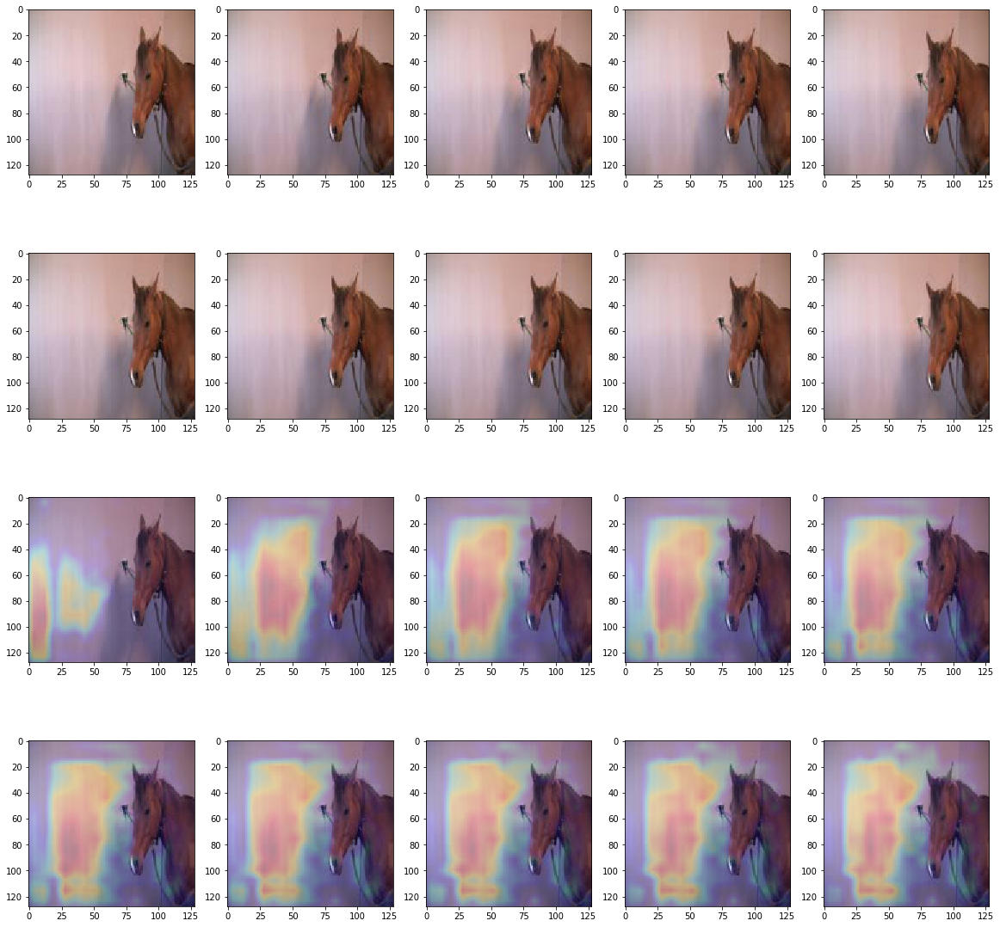

[ 0.62745851  0.34381947]
[ 0.4110468   0.47083652]
[ 0.13277236  0.71039963]
[ 0.03225257  0.8802678 ]
[ 0.00970236  0.94786453]
[ 0.00475005  0.97559971]
[ 0.00313874  0.98609471]
[ 0.00250933  0.99121207]
[ 0.00227388  0.99196702]
[ 0.00220075  0.99188763]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [24]:
with sess.as_default():

    # 2-stream
    if two_stream:
        prob = sess.run(clstm_model.preds,
                        feed_dict={images: batch_img,
                                   flows: batch_flow,
                                   K.learning_phase(): 0})

        print(prob)

        gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value = \
            sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                      feed_dict={images: batch_img,
                                 flows: batch_flow,
                                 labels: batch_label,
                                 K.learning_phase(): 0})

        target_conv_layer_value = np.reshape(target_conv_layer_value,
                                         (1, 10, 8, 8, 32))
        target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                         (1, 10, 8, 8, 32))
    else:
        prob = sess.run(clstm_model.preds,
                        feed_dict={images: batch_img,
                                   K.learning_phase(): 0})

        print(prob)
        gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value = \
            sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                      feed_dict={images: batch_img,
                      labels: batch_label,
                      K.learning_phase(): 0})
        
        target_conv_layer_value = np.reshape(target_conv_layer_value,
                                         (1, 10, 16, 16, 32))
        target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                         (1, 10, 16, 16, 32))


    visualize_overlays(batch_img, target_conv_layer_value,
                       target_conv_layer_grad_value)

    for i in range(seq_length):
        print(prob[0,i,:])
    print(batch_label)

In [27]:
def run_on_one_sequence(batch_img, batch_flow):
    with sess.as_default():

        # 2-stream
        if two_stream:
            prob = sess.run(clstm_model.preds,
                            feed_dict={images: batch_img,
                                       flows: batch_flow,
                                       K.learning_phase(): 0})

            print(prob)

            gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value = \
                sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                          feed_dict={images: batch_img,
                                     flows: batch_flow,
                                     labels: batch_label,
                                     K.learning_phase(): 0})

            target_conv_layer_value = np.reshape(target_conv_layer_value,
                                             (1, 10, 8, 8, 32))
            target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                             (1, 10, 8, 8, 32))
        else:
            prob = sess.run(clstm_model.preds,
                            feed_dict={images: batch_img,
                                       K.learning_phase(): 0})

            print(prob)
            gb_grad_value, target_conv_layer_value, target_conv_layer_grad_value = \
                sess.run([gb_grad, target_conv_layer, target_conv_layer_grad],
                          feed_dict={images: batch_img,
                          labels: batch_label,
                          K.learning_phase(): 0})
            target_conv_layer_value = np.reshape(target_conv_layer_value,
                                         (1, 10, 16, 16, 32))
            target_conv_layer_grad_value = np.reshape(target_conv_layer_grad_value,
                                         (1, 10, 16, 16, 32))


        visualize_overlays(batch_img, target_conv_layer_value,
                           target_conv_layer_grad_value)

        for i in range(seq_length):
            print(prob[0,i,:])
        print(batch_label)

# Two-stream predictions for subject 5

[[[ 0.75034589  0.19071661]
  [ 0.90479201  0.04453638]
  [ 0.9694038   0.01345732]
  [ 0.98725253  0.00771627]
  [ 0.99290717  0.00655581]
  [ 0.99551457  0.00615968]
  [ 0.99689519  0.00558112]
  [ 0.99771488  0.00496736]
  [ 0.99794859  0.00497079]
  [ 0.99767095  0.00573191]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


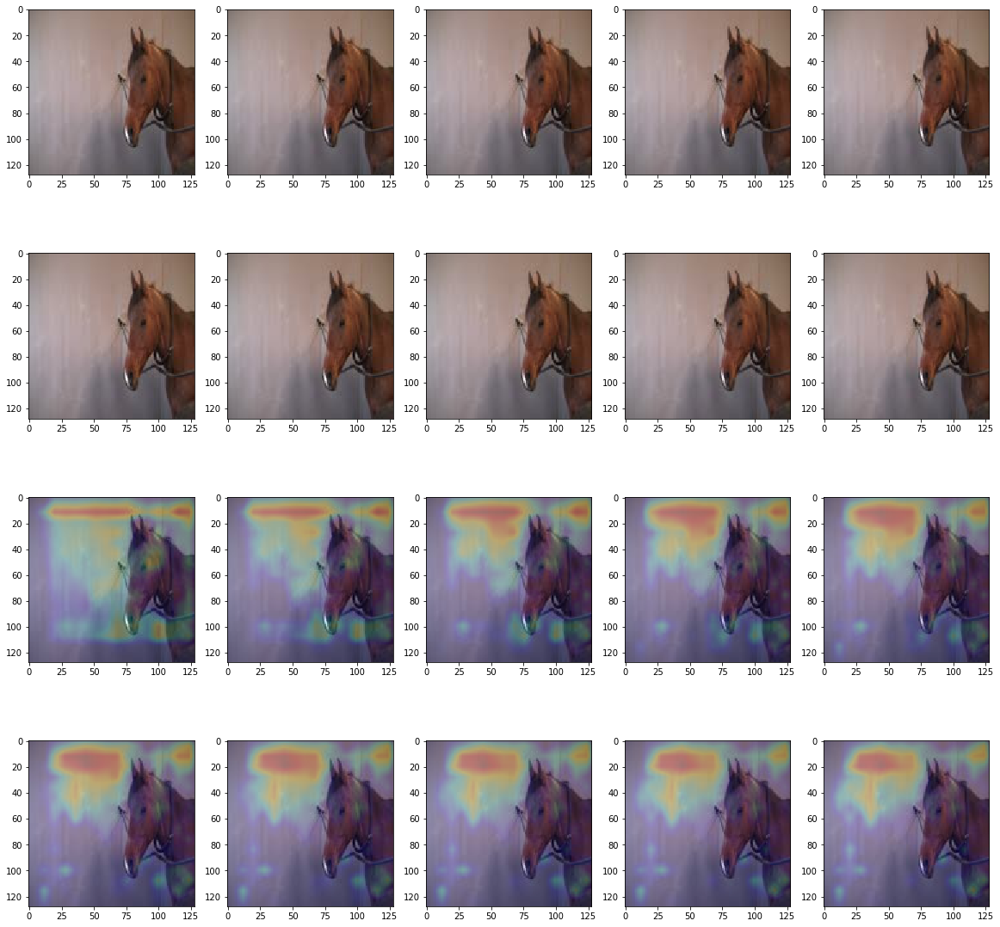

[ 0.75034589  0.19071661]
[ 0.90479201  0.04453638]
[ 0.9694038   0.01345732]
[ 0.98725253  0.00771627]
[ 0.99290717  0.00655581]
[ 0.99551457  0.00615968]
[ 0.99689519  0.00558112]
[ 0.99771488  0.00496736]
[ 0.99794859  0.00497079]
[ 0.99767095  0.00573191]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [28]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.64300406  0.31788754]
  [ 0.64574617  0.34673056]
  [ 0.6324051   0.38279706]
  [ 0.63754779  0.34071669]
  [ 0.69333893  0.29313576]
  [ 0.74890095  0.25794849]
  [ 0.7854563   0.22487439]
  [ 0.81325418  0.18707356]
  [ 0.81265253  0.16284963]
  [ 0.81438076  0.1506965 ]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


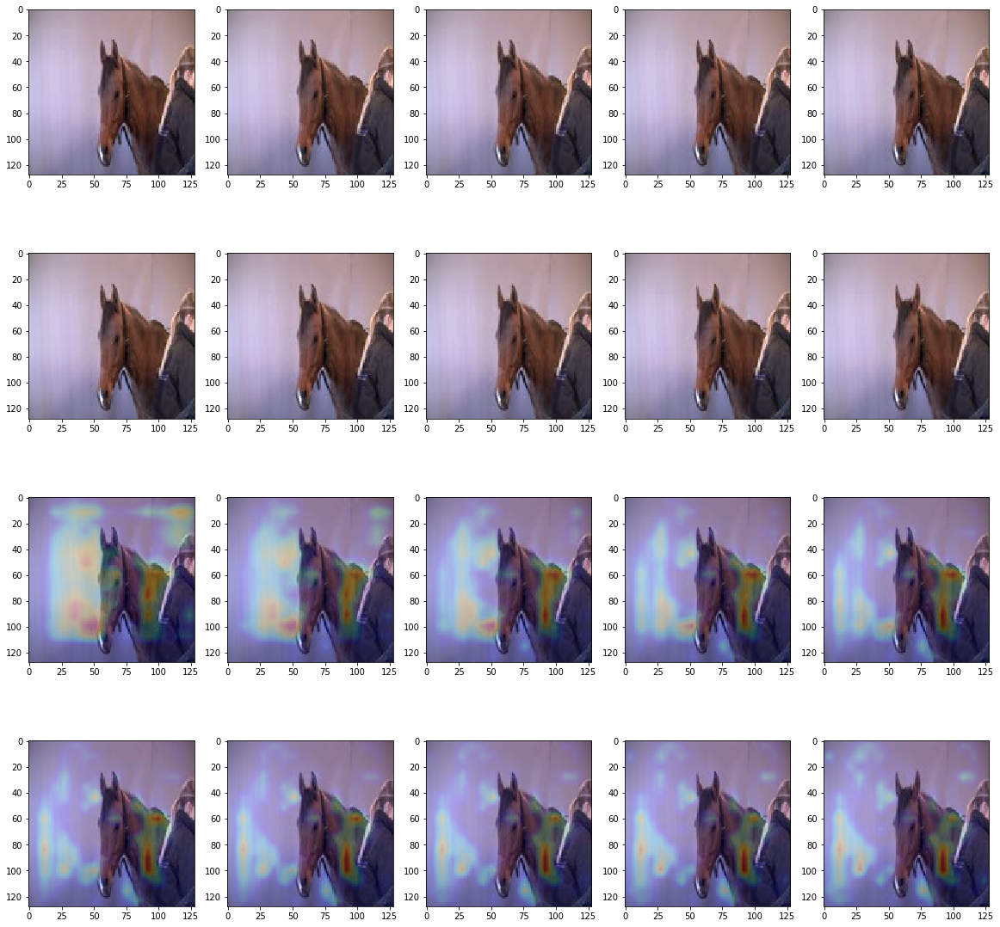

[ 0.64300406  0.31788754]
[ 0.64574617  0.34673056]
[ 0.6324051   0.38279706]
[ 0.63754779  0.34071669]
[ 0.69333893  0.29313576]
[ 0.74890095  0.25794849]
[ 0.7854563   0.22487439]
[ 0.81325418  0.18707356]
[ 0.81265253  0.16284963]
[ 0.81438076  0.1506965 ]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [29]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.65965611  0.32298157]
  [ 0.69268698  0.28537697]
  [ 0.70842475  0.25399968]
  [ 0.73756349  0.20548287]
  [ 0.78506958  0.12865636]
  [ 0.82383496  0.07378188]
  [ 0.82654226  0.05310696]
  [ 0.8297267   0.04435231]
  [ 0.82543898  0.04734582]
  [ 0.82740015  0.05966899]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


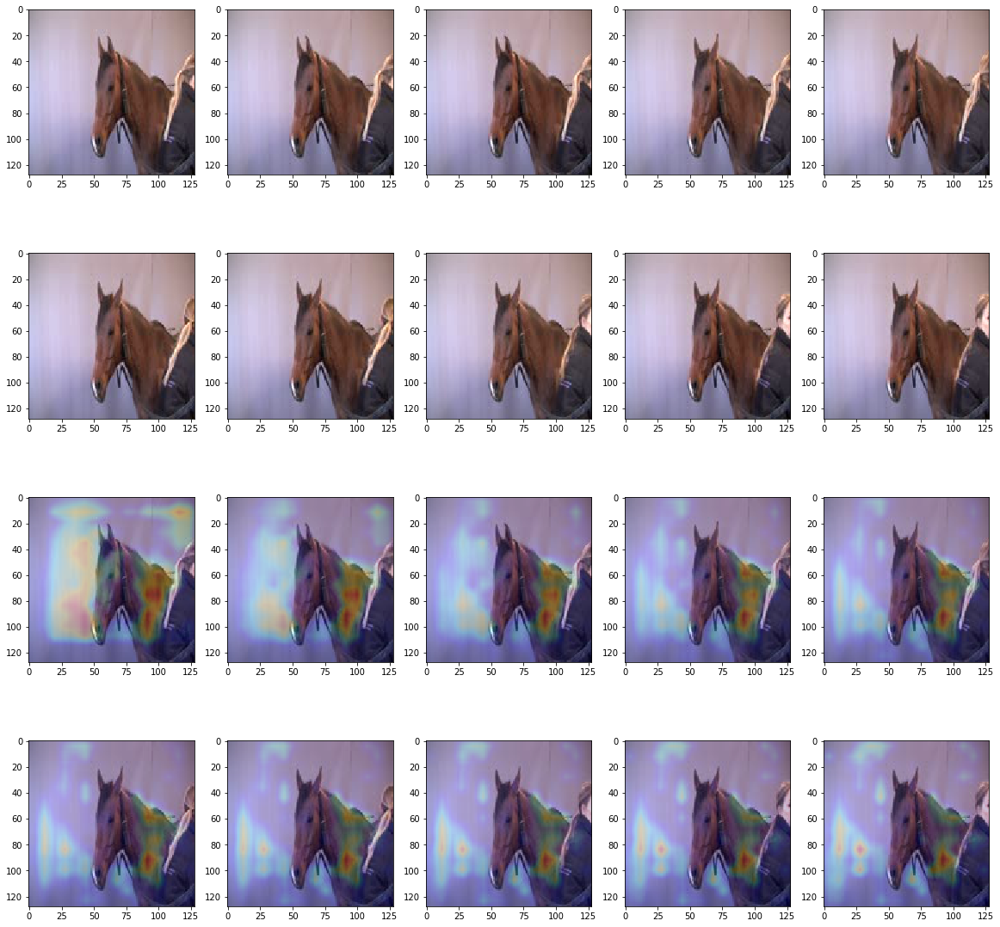

[ 0.65965611  0.32298157]
[ 0.69268698  0.28537697]
[ 0.70842475  0.25399968]
[ 0.73756349  0.20548287]
[ 0.78506958  0.12865636]
[ 0.82383496  0.07378188]
[ 0.82654226  0.05310696]
[ 0.8297267   0.04435231]
[ 0.82543898  0.04734582]
[ 0.82740015  0.05966899]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [30]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.56421626  0.38635185]
  [ 0.41579163  0.54096341]
  [ 0.21435347  0.76849639]
  [ 0.07634918  0.89886749]
  [ 0.03283655  0.95172381]
  [ 0.01829428  0.97356737]
  [ 0.01214526  0.98352098]
  [ 0.00763115  0.98850399]
  [ 0.00587339  0.99181503]
  [ 0.00436681  0.99282515]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


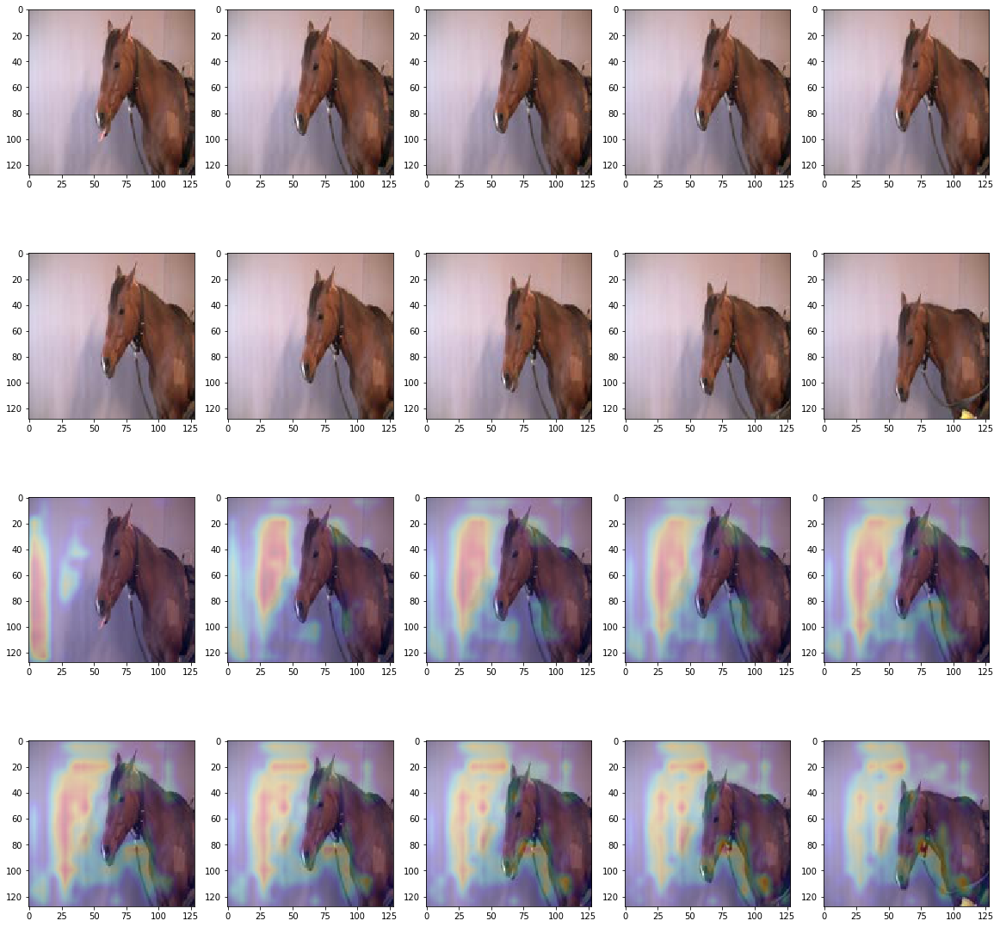

[ 0.56421626  0.38635185]
[ 0.41579163  0.54096341]
[ 0.21435347  0.76849639]
[ 0.07634918  0.89886749]
[ 0.03283655  0.95172381]
[ 0.01829428  0.97356737]
[ 0.01214526  0.98352098]
[ 0.00763115  0.98850399]
[ 0.00587339  0.99181503]
[ 0.00436681  0.99282515]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [31]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.62902647  0.32298774]
  [ 0.54493743  0.37053719]
  [ 0.36719966  0.5294109 ]
  [ 0.16988002  0.70475167]
  [ 0.07223111  0.76663685]
  [ 0.03559584  0.80735141]
  [ 0.017597    0.83871132]
  [ 0.01104885  0.84207964]
  [ 0.00980713  0.85862935]
  [ 0.00819652  0.87250775]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


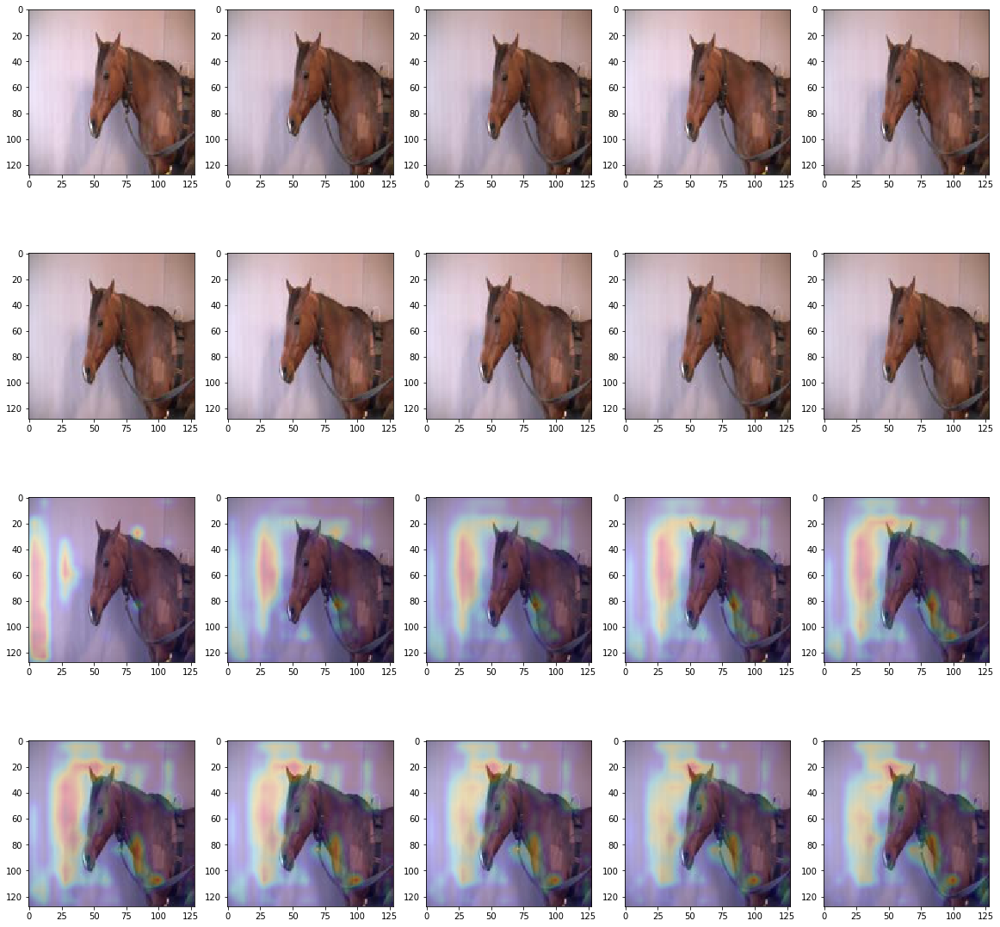

[ 0.62902647  0.32298774]
[ 0.54493743  0.37053719]
[ 0.36719966  0.5294109 ]
[ 0.16988002  0.70475167]
[ 0.07223111  0.76663685]
[ 0.03559584  0.80735141]
[ 0.017597    0.83871132]
[ 0.01104885  0.84207964]
[ 0.00980713  0.85862935]
[ 0.00819652  0.87250775]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [32]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.70682609  0.24386191]
  [ 0.82806468  0.17999211]
  [ 0.90513259  0.21482243]
  [ 0.94527751  0.23609015]
  [ 0.96429938  0.20477918]
  [ 0.97379375  0.16099124]
  [ 0.97971648  0.14458346]
  [ 0.98344815  0.14284302]
  [ 0.98066276  0.13470316]
  [ 0.9795236   0.11939718]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


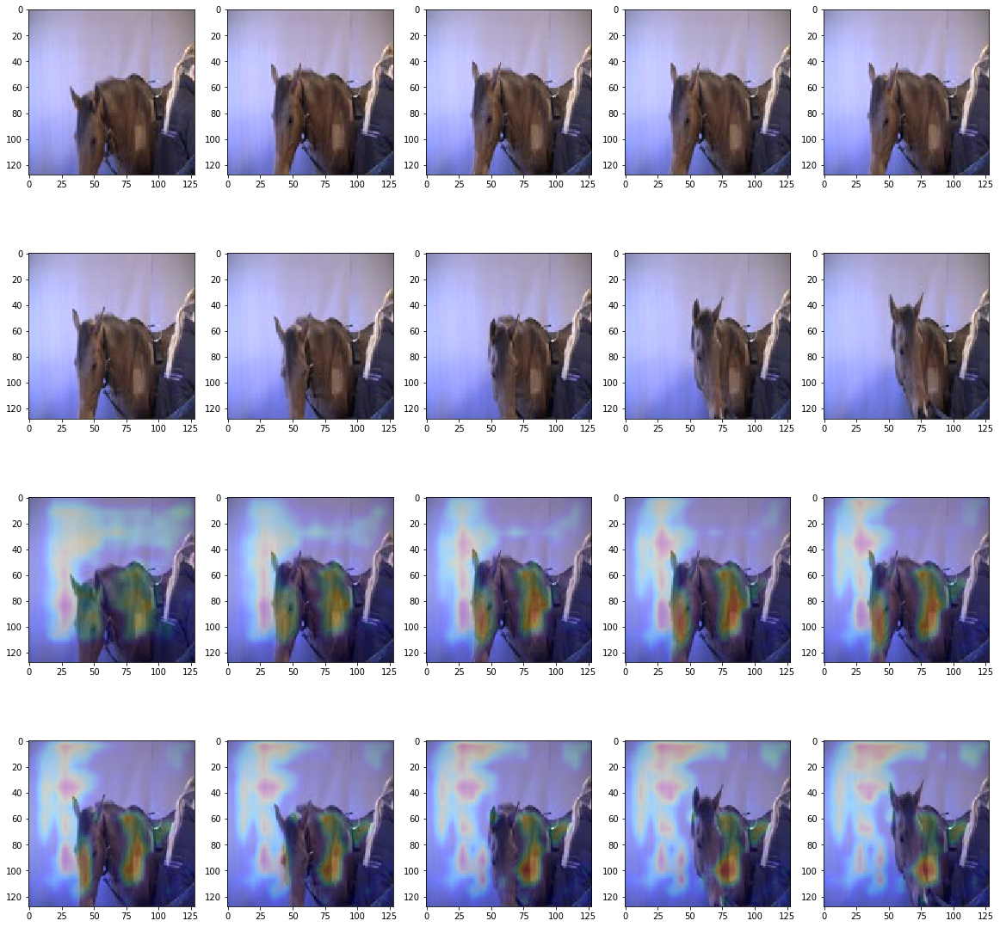

[ 0.70682609  0.24386191]
[ 0.82806468  0.17999211]
[ 0.90513259  0.21482243]
[ 0.94527751  0.23609015]
[ 0.96429938  0.20477918]
[ 0.97379375  0.16099124]
[ 0.97971648  0.14458346]
[ 0.98344815  0.14284302]
[ 0.98066276  0.13470316]
[ 0.9795236   0.11939718]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [33]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66854149  0.36673582]
  [ 0.6923483   0.35751021]
  [ 0.70222831  0.30791256]
  [ 0.73515135  0.22750214]
  [ 0.79312491  0.17173934]
  [ 0.85962766  0.11237872]
  [ 0.88276106  0.07092739]
  [ 0.88257378  0.0559428 ]
  [ 0.86238903  0.05404158]
  [ 0.82109421  0.06076656]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


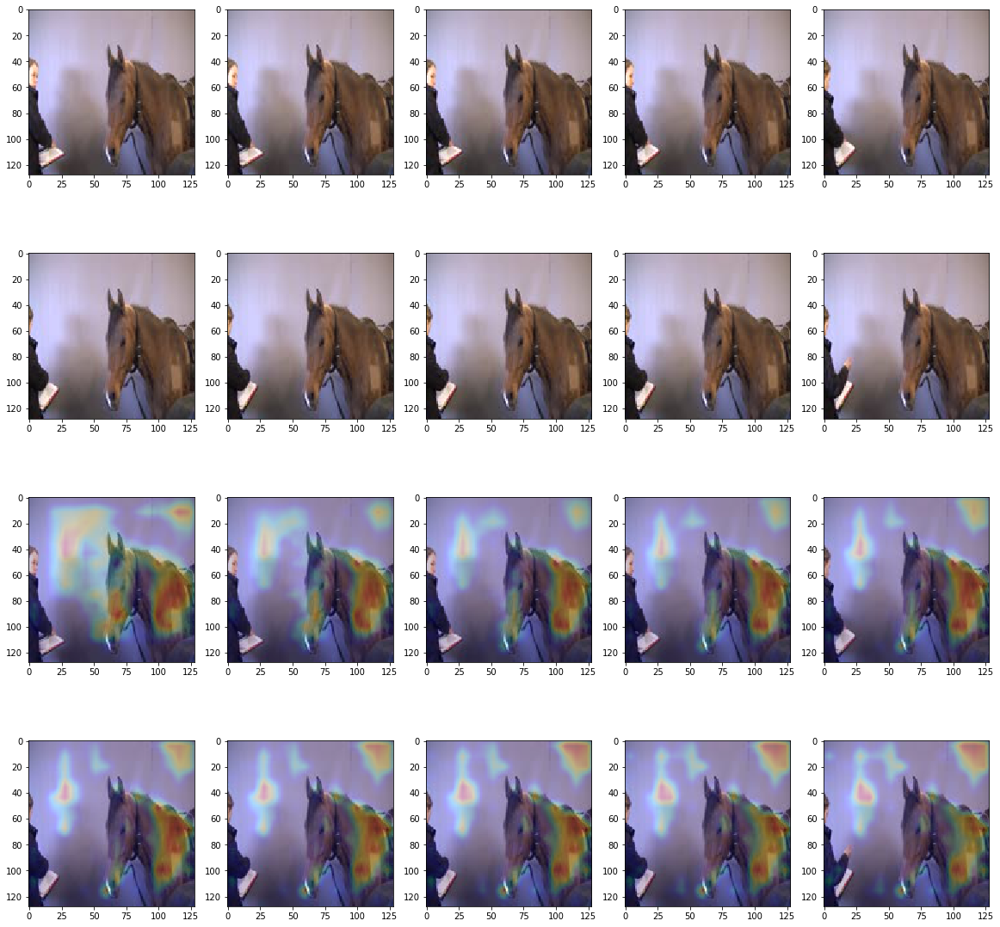

[ 0.66854149  0.36673582]
[ 0.6923483   0.35751021]
[ 0.70222831  0.30791256]
[ 0.73515135  0.22750214]
[ 0.79312491  0.17173934]
[ 0.85962766  0.11237872]
[ 0.88276106  0.07092739]
[ 0.88257378  0.0559428 ]
[ 0.86238903  0.05404158]
[ 0.82109421  0.06076656]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [34]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.62867421  0.32101086]
  [ 0.54503459  0.35063258]
  [ 0.38456804  0.57561773]
  [ 0.23391001  0.77172041]
  [ 0.15580183  0.87072134]
  [ 0.1100615   0.91553342]
  [ 0.08978403  0.94408154]
  [ 0.07076252  0.96225357]
  [ 0.06902243  0.96661603]
  [ 0.07097359  0.96776086]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


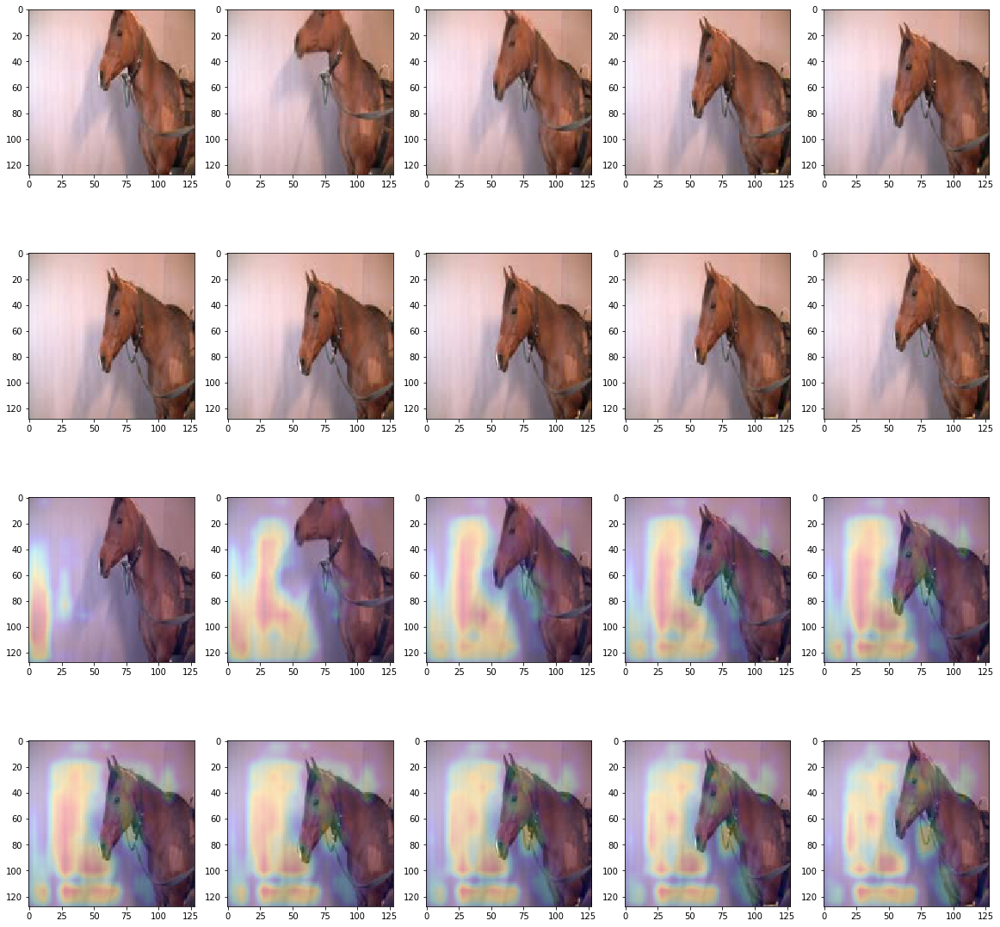

[ 0.62867421  0.32101086]
[ 0.54503459  0.35063258]
[ 0.38456804  0.57561773]
[ 0.23391001  0.77172041]
[ 0.15580183  0.87072134]
[ 0.1100615   0.91553342]
[ 0.08978403  0.94408154]
[ 0.07076252  0.96225357]
[ 0.06902243  0.96661603]
[ 0.07097359  0.96776086]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [35]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.65207428  0.29996824]
  [ 0.62021661  0.29276073]
  [ 0.52667409  0.37633413]
  [ 0.44328469  0.55562866]
  [ 0.4194195   0.60811955]
  [ 0.44715694  0.55098301]
  [ 0.49311036  0.47605559]
  [ 0.53403813  0.45168602]
  [ 0.55448937  0.42921224]
  [ 0.57200944  0.36776718]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


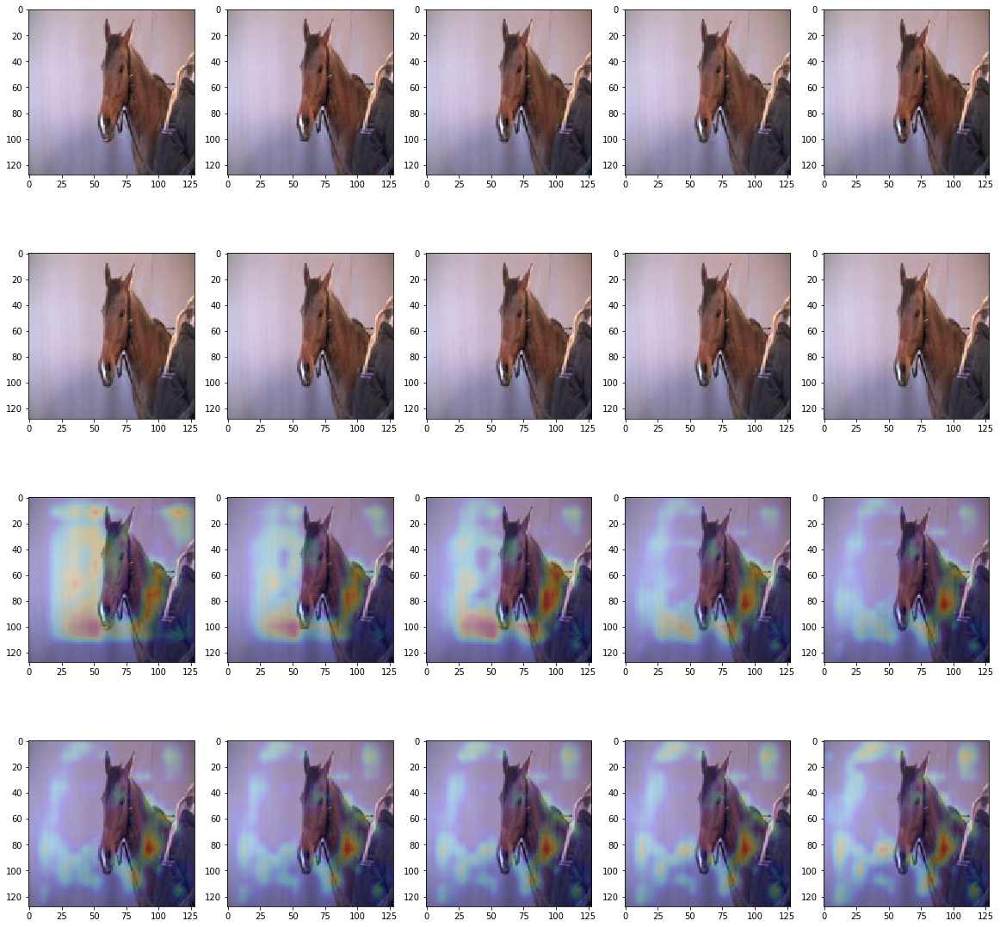

[ 0.65207428  0.29996824]
[ 0.62021661  0.29276073]
[ 0.52667409  0.37633413]
[ 0.44328469  0.55562866]
[ 0.4194195   0.60811955]
[ 0.44715694  0.55098301]
[ 0.49311036  0.47605559]
[ 0.53403813  0.45168602]
[ 0.55448937  0.42921224]
[ 0.57200944  0.36776718]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [36]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.73826301  0.2211936 ]
  [ 0.82302678  0.14271225]
  [ 0.85548574  0.14301251]
  [ 0.87221444  0.1487058 ]
  [ 0.89633584  0.18487838]
  [ 0.90434068  0.24570115]
  [ 0.92523748  0.30088523]
  [ 0.94646615  0.3191835 ]
  [ 0.95642197  0.32341641]
  [ 0.96225899  0.3214629 ]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


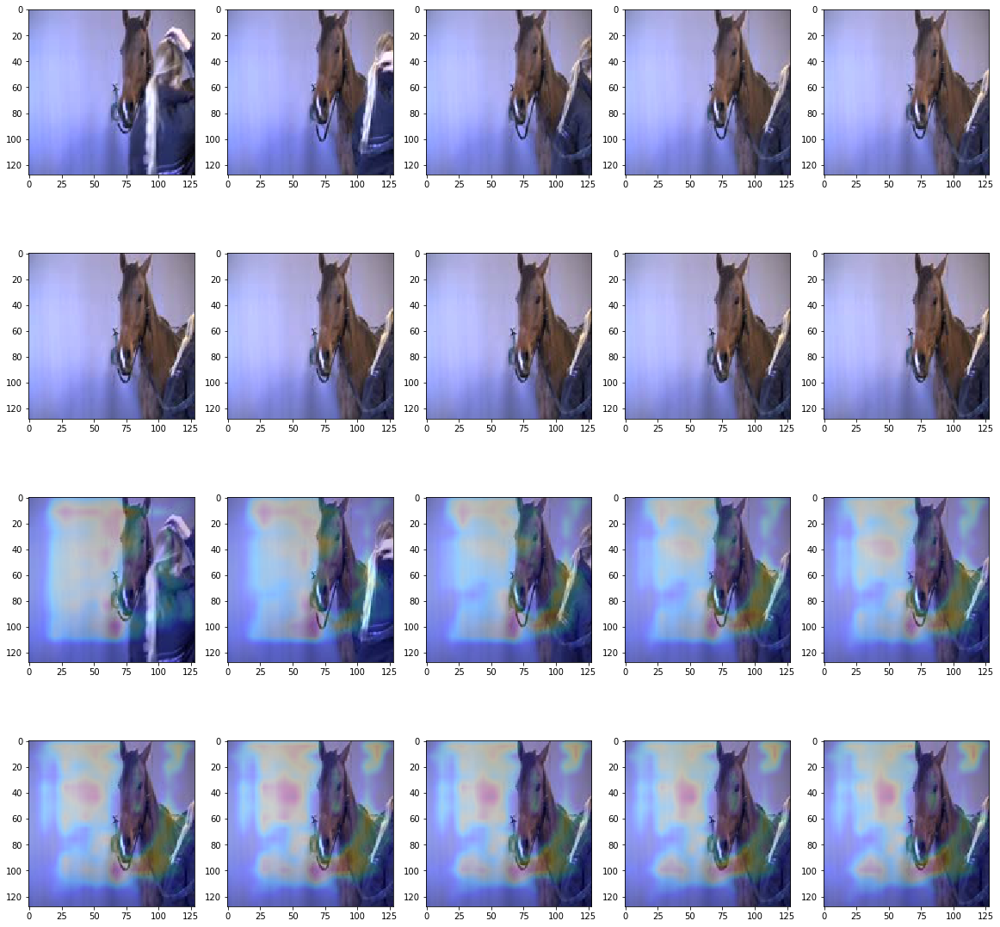

[ 0.73826301  0.2211936 ]
[ 0.82302678  0.14271225]
[ 0.85548574  0.14301251]
[ 0.87221444  0.1487058 ]
[ 0.89633584  0.18487838]
[ 0.90434068  0.24570115]
[ 0.92523748  0.30088523]
[ 0.94646615  0.3191835 ]
[ 0.95642197  0.32341641]
[ 0.96225899  0.3214629 ]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [37]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66477722  0.41158751]
  [ 0.68657804  0.61630672]
  [ 0.53132313  0.87475818]
  [ 0.25063732  0.95505899]
  [ 0.09222648  0.97658986]
  [ 0.04729705  0.98538929]
  [ 0.02502915  0.98792946]
  [ 0.01605444  0.98637253]
  [ 0.01152801  0.98464495]
  [ 0.00883923  0.9833535 ]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


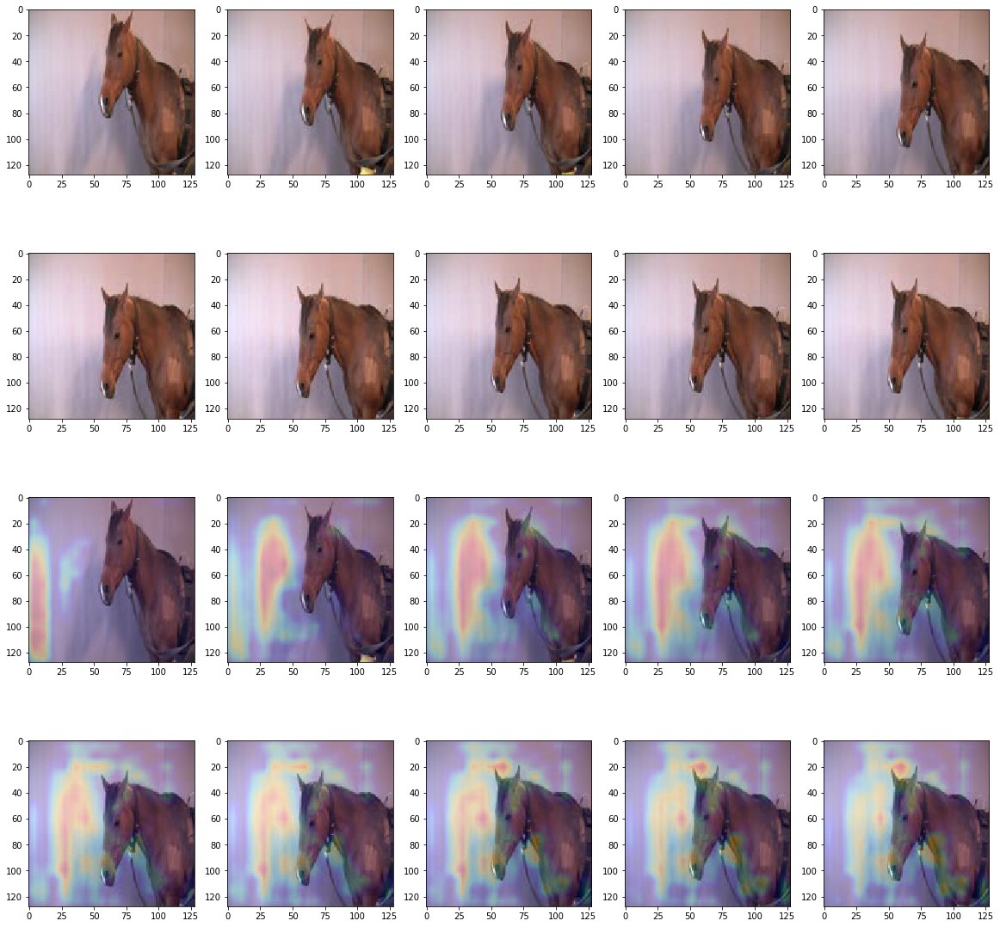

[ 0.66477722  0.41158751]
[ 0.68657804  0.61630672]
[ 0.53132313  0.87475818]
[ 0.25063732  0.95505899]
[ 0.09222648  0.97658986]
[ 0.04729705  0.98538929]
[ 0.02502915  0.98792946]
[ 0.01605444  0.98637253]
[ 0.01152801  0.98464495]
[ 0.00883923  0.9833535 ]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [38]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.74811232  0.19283195]
  [ 0.90490609  0.04276733]
  [ 0.96531737  0.01062426]
  [ 0.98307365  0.00503907]
  [ 0.98764741  0.00445902]
  [ 0.98939556  0.00526134]
  [ 0.99004084  0.00861248]
  [ 0.98789412  0.01610943]
  [ 0.9847489   0.02441038]
  [ 0.98212159  0.03690154]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


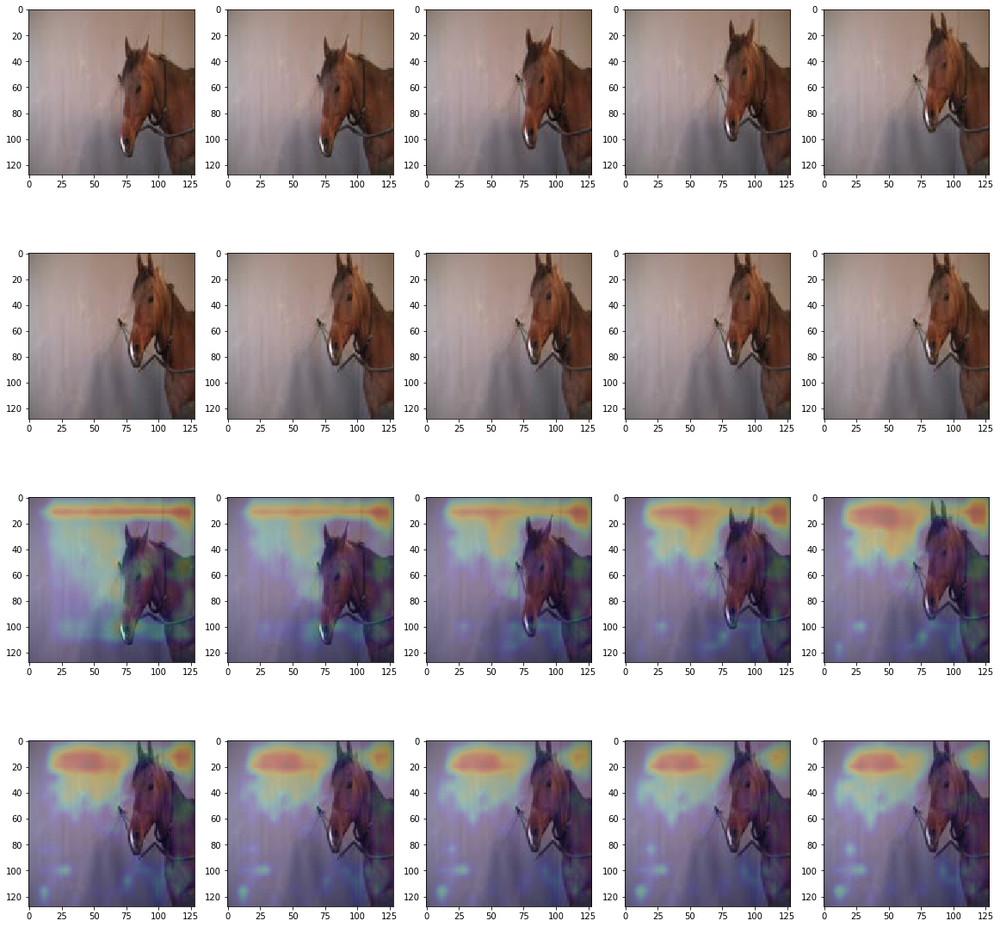

[ 0.74811232  0.19283195]
[ 0.90490609  0.04276733]
[ 0.96531737  0.01062426]
[ 0.98307365  0.00503907]
[ 0.98764741  0.00445902]
[ 0.98939556  0.00526134]
[ 0.99004084  0.00861248]
[ 0.98789412  0.01610943]
[ 0.9847489   0.02441038]
[ 0.98212159  0.03690154]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [39]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.64363104  0.38479239]
  [ 0.61660349  0.50314403]
  [ 0.45807442  0.71333545]
  [ 0.24571933  0.84352362]
  [ 0.13063885  0.88435298]
  [ 0.07591454  0.88156062]
  [ 0.05313501  0.87100691]
  [ 0.04142157  0.85604906]
  [ 0.03706138  0.85119778]
  [ 0.03383392  0.84599781]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


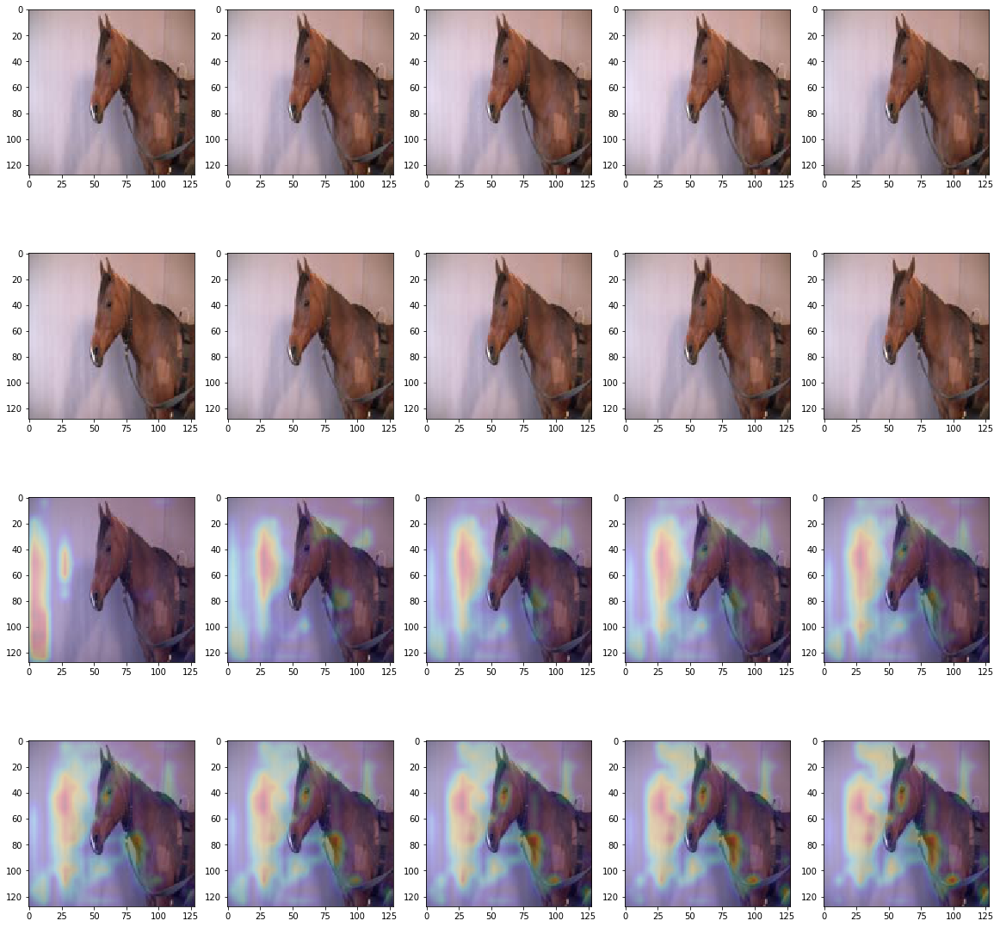

[ 0.64363104  0.38479239]
[ 0.61660349  0.50314403]
[ 0.45807442  0.71333545]
[ 0.24571933  0.84352362]
[ 0.13063885  0.88435298]
[ 0.07591454  0.88156062]
[ 0.05313501  0.87100691]
[ 0.04142157  0.85604906]
[ 0.03706138  0.85119778]
[ 0.03383392  0.84599781]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [40]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.56508178  0.40478027]
  [ 0.46170127  0.53388768]
  [ 0.31608093  0.70053834]
  [ 0.16289671  0.8204605 ]
  [ 0.08123384  0.88773805]
  [ 0.04311704  0.90693939]
  [ 0.02842047  0.90277851]
  [ 0.02337757  0.88780075]
  [ 0.02344566  0.86508989]
  [ 0.02522807  0.84885246]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


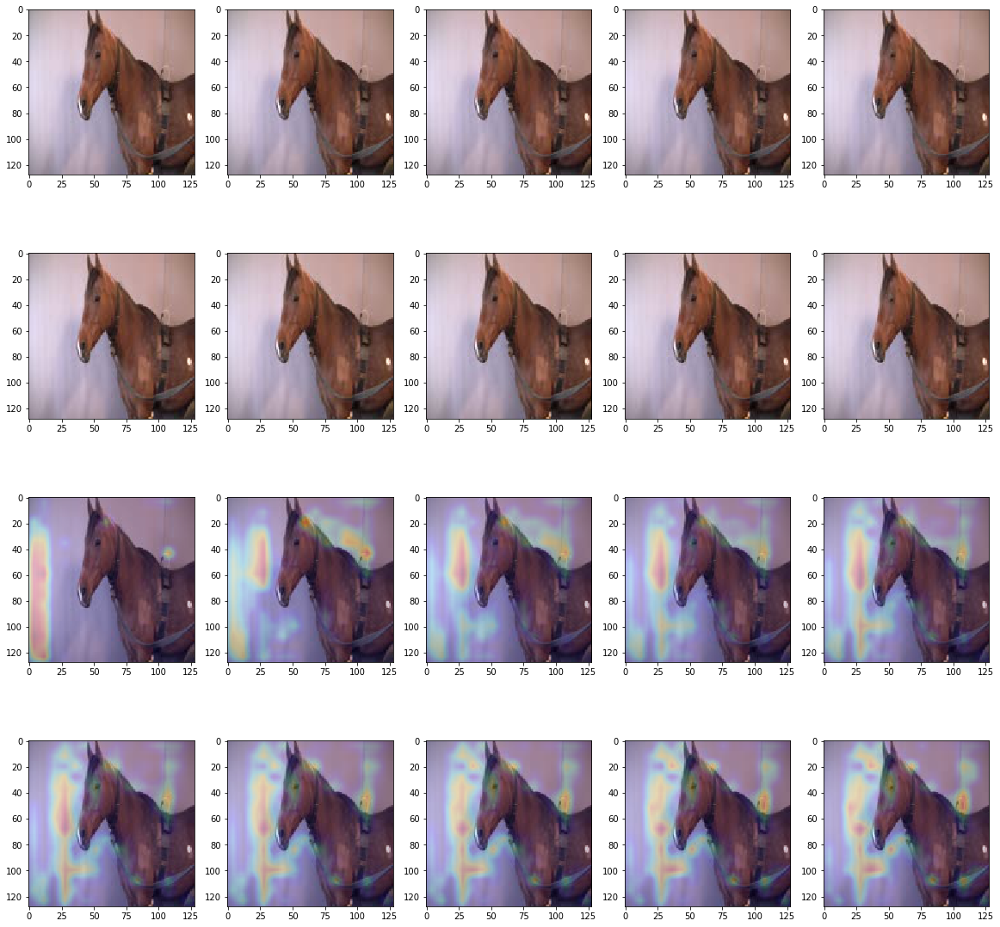

[ 0.56508178  0.40478027]
[ 0.46170127  0.53388768]
[ 0.31608093  0.70053834]
[ 0.16289671  0.8204605 ]
[ 0.08123384  0.88773805]
[ 0.04311704  0.90693939]
[ 0.02842047  0.90277851]
[ 0.02337757  0.88780075]
[ 0.02344566  0.86508989]
[ 0.02522807  0.84885246]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [41]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.70413631  0.3512229 ]
  [ 0.74006742  0.38595736]
  [ 0.66392773  0.45806208]
  [ 0.61583102  0.40318635]
  [ 0.64908445  0.33813214]
  [ 0.66202182  0.28482729]
  [ 0.68911213  0.1978927 ]
  [ 0.67440206  0.15498297]
  [ 0.62607372  0.12880774]
  [ 0.57429826  0.11732513]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


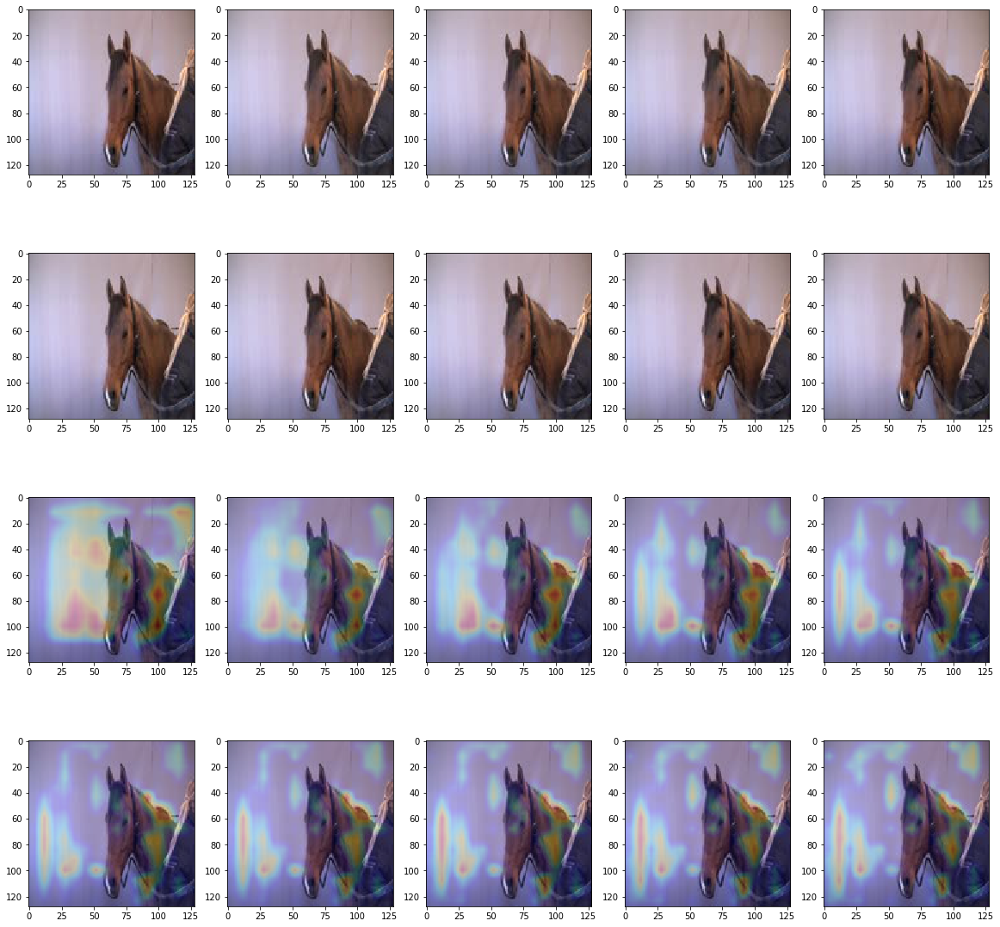

[ 0.70413631  0.3512229 ]
[ 0.74006742  0.38595736]
[ 0.66392773  0.45806208]
[ 0.61583102  0.40318635]
[ 0.64908445  0.33813214]
[ 0.66202182  0.28482729]
[ 0.68911213  0.1978927 ]
[ 0.67440206  0.15498297]
[ 0.62607372  0.12880774]
[ 0.57429826  0.11732513]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [42]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.6390841   0.32798794]
  [ 0.73139948  0.29742166]
  [ 0.79177862  0.30590558]
  [ 0.86618978  0.25741002]
  [ 0.891936    0.18561128]
  [ 0.91836125  0.12296576]
  [ 0.92633522  0.10316858]
  [ 0.92840117  0.07976688]
  [ 0.91514838  0.0647736 ]
  [ 0.89339781  0.05144051]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


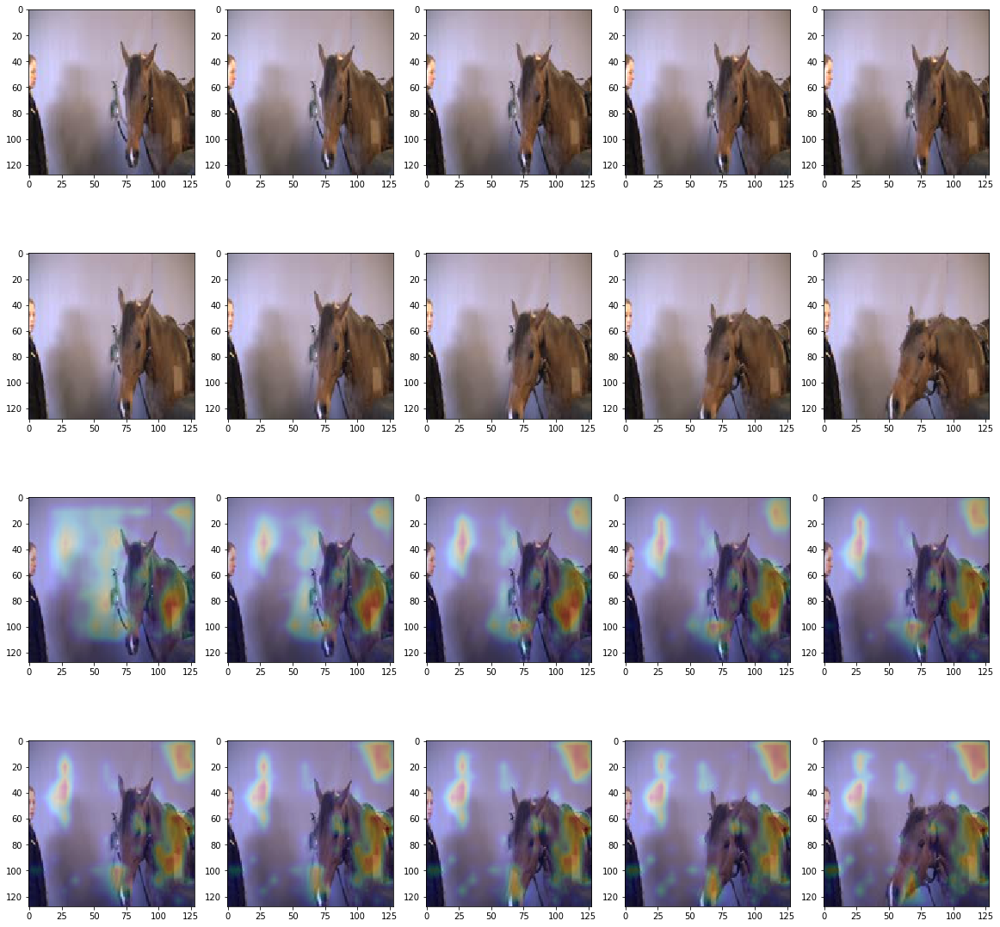

[ 0.6390841   0.32798794]
[ 0.73139948  0.29742166]
[ 0.79177862  0.30590558]
[ 0.86618978  0.25741002]
[ 0.891936    0.18561128]
[ 0.91836125  0.12296576]
[ 0.92633522  0.10316858]
[ 0.92840117  0.07976688]
[ 0.91514838  0.0647736 ]
[ 0.89339781  0.05144051]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [43]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66308481  0.31515613]
  [ 0.61693913  0.32071191]
  [ 0.45514154  0.46298304]
  [ 0.31460607  0.66683441]
  [ 0.22604959  0.77084088]
  [ 0.16862507  0.78211069]
  [ 0.12010181  0.73365885]
  [ 0.09655064  0.68261528]
  [ 0.08469927  0.62274235]
  [ 0.08717124  0.56892109]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


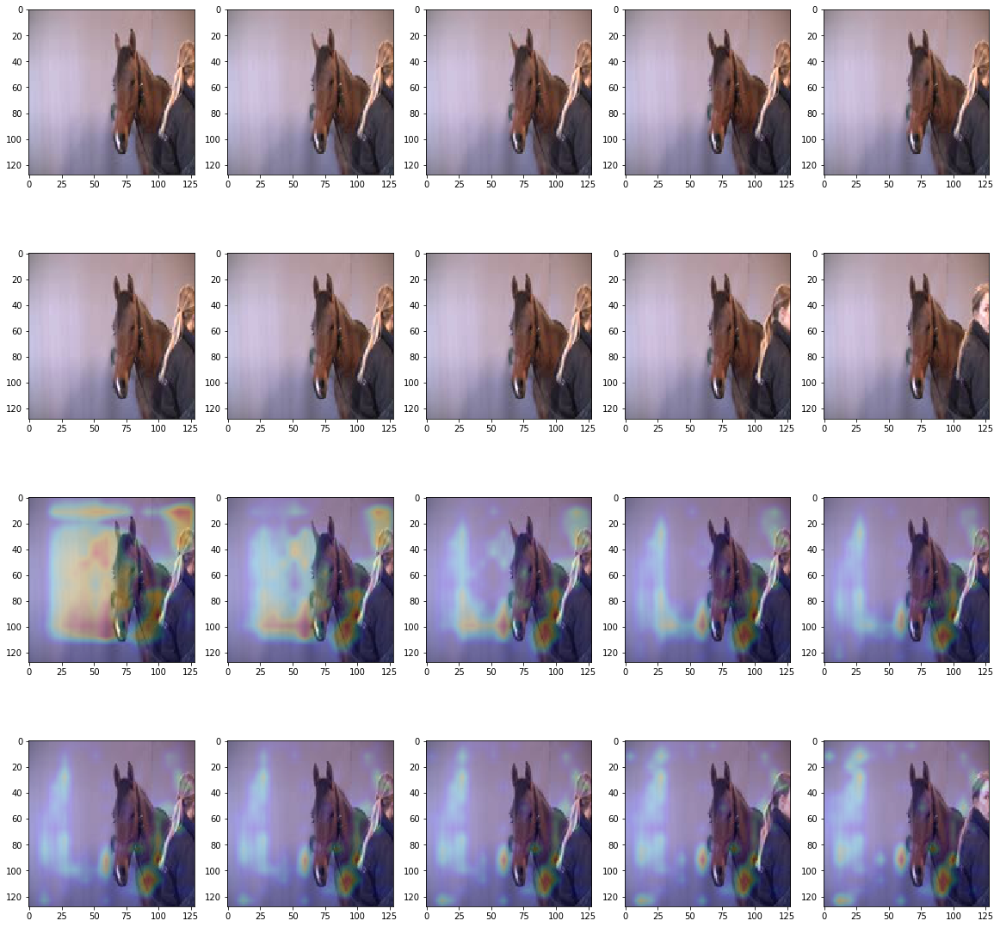

[ 0.66308481  0.31515613]
[ 0.61693913  0.32071191]
[ 0.45514154  0.46298304]
[ 0.31460607  0.66683441]
[ 0.22604959  0.77084088]
[ 0.16862507  0.78211069]
[ 0.12010181  0.73365885]
[ 0.09655064  0.68261528]
[ 0.08469927  0.62274235]
[ 0.08717124  0.56892109]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [44]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.76255375  0.1966124 ]
  [ 0.91450387  0.04706096]
  [ 0.97379792  0.01584477]
  [ 0.99041712  0.00868036]
  [ 0.99481899  0.00799787]
  [ 0.99652439  0.00803015]
  [ 0.99746227  0.0087107 ]
  [ 0.99791247  0.00891192]
  [ 0.99778581  0.00954179]
  [ 0.99758863  0.01100246]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


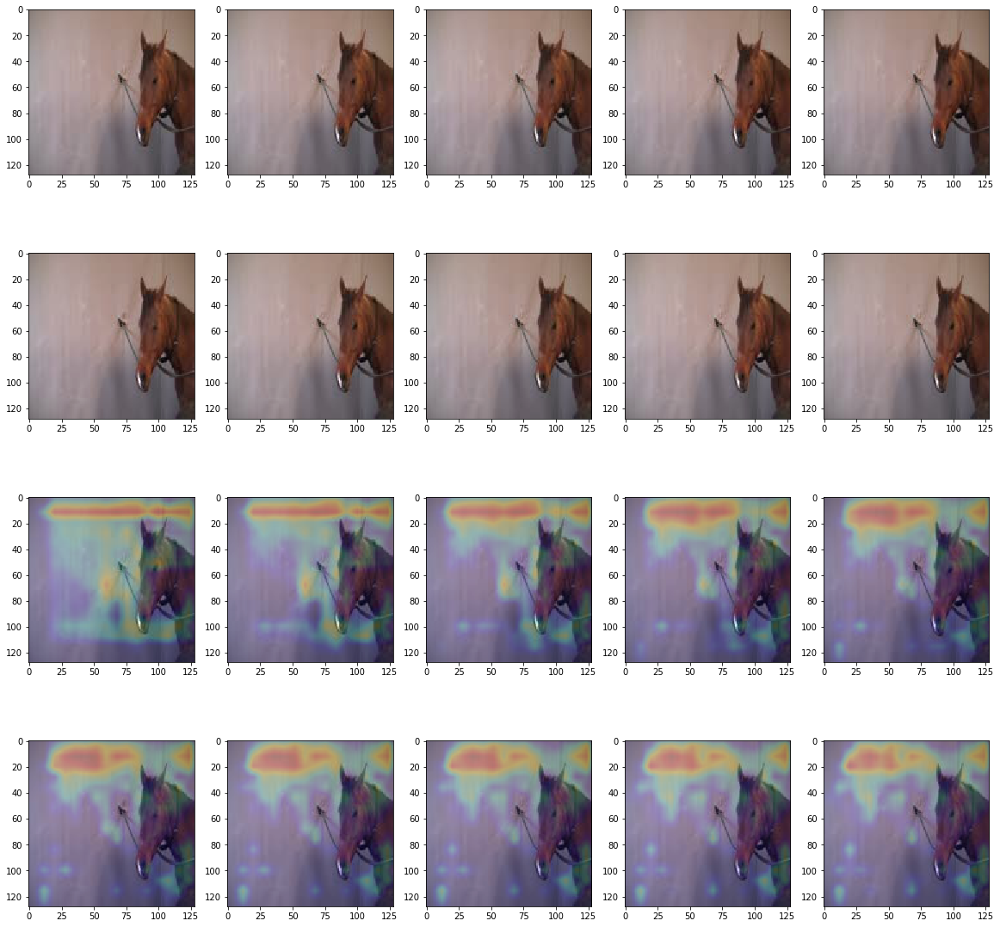

[ 0.76255375  0.1966124 ]
[ 0.91450387  0.04706096]
[ 0.97379792  0.01584477]
[ 0.99041712  0.00868036]
[ 0.99481899  0.00799787]
[ 0.99652439  0.00803015]
[ 0.99746227  0.0087107 ]
[ 0.99791247  0.00891192]
[ 0.99778581  0.00954179]
[ 0.99758863  0.01100246]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [45]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69880736  0.22711432]
  [ 0.84480518  0.11701053]
  [ 0.94411772  0.09034885]
  [ 0.97793853  0.10274494]
  [ 0.9880603   0.1069432 ]
  [ 0.99221438  0.13393472]
  [ 0.99415827  0.16782105]
  [ 0.99481213  0.22423577]
  [ 0.99584216  0.25773227]
  [ 0.99686557  0.26970923]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


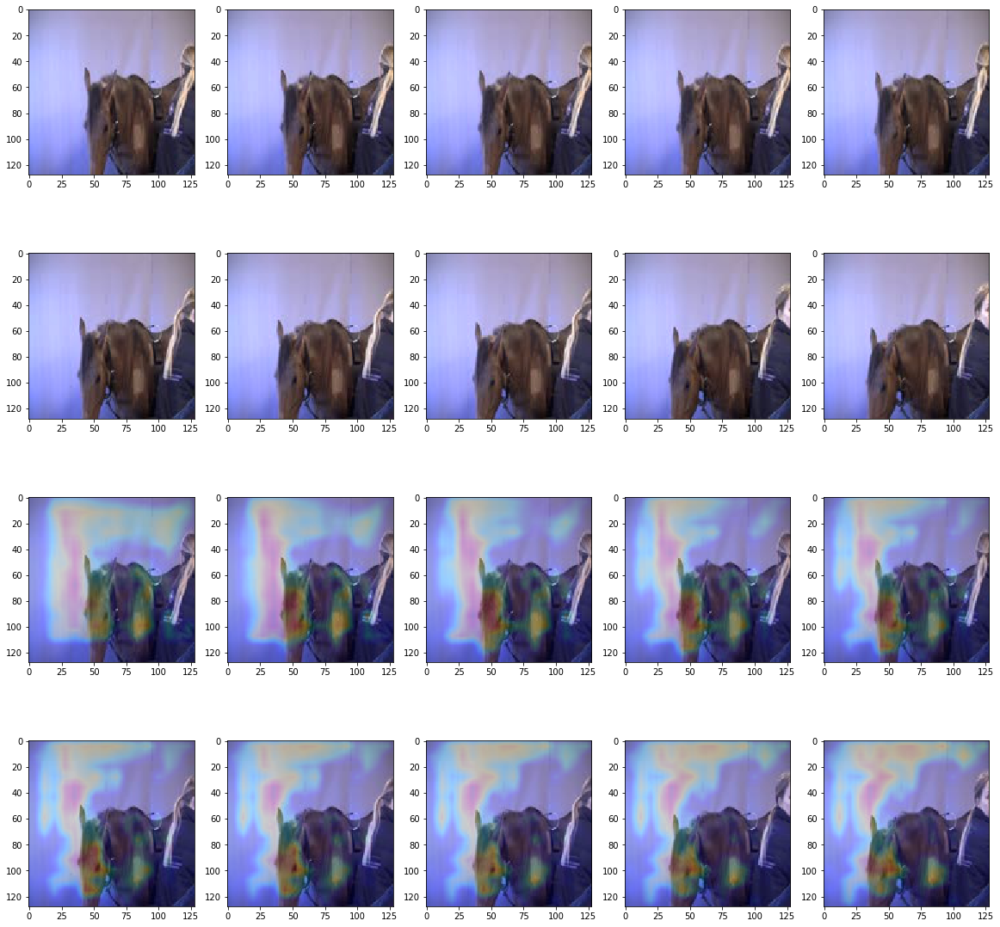

[ 0.69880736  0.22711432]
[ 0.84480518  0.11701053]
[ 0.94411772  0.09034885]
[ 0.97793853  0.10274494]
[ 0.9880603  0.1069432]
[ 0.99221438  0.13393472]
[ 0.99415827  0.16782105]
[ 0.99481213  0.22423577]
[ 0.99584216  0.25773227]
[ 0.99686557  0.26970923]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [46]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66944605  0.32769194]
  [ 0.66515642  0.36557907]
  [ 0.53943586  0.58612013]
  [ 0.33805996  0.79737234]
  [ 0.20410544  0.89303339]
  [ 0.14530368  0.94853723]
  [ 0.12193459  0.97470278]
  [ 0.11744729  0.98098135]
  [ 0.10668821  0.98615438]
  [ 0.07554537  0.98525745]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


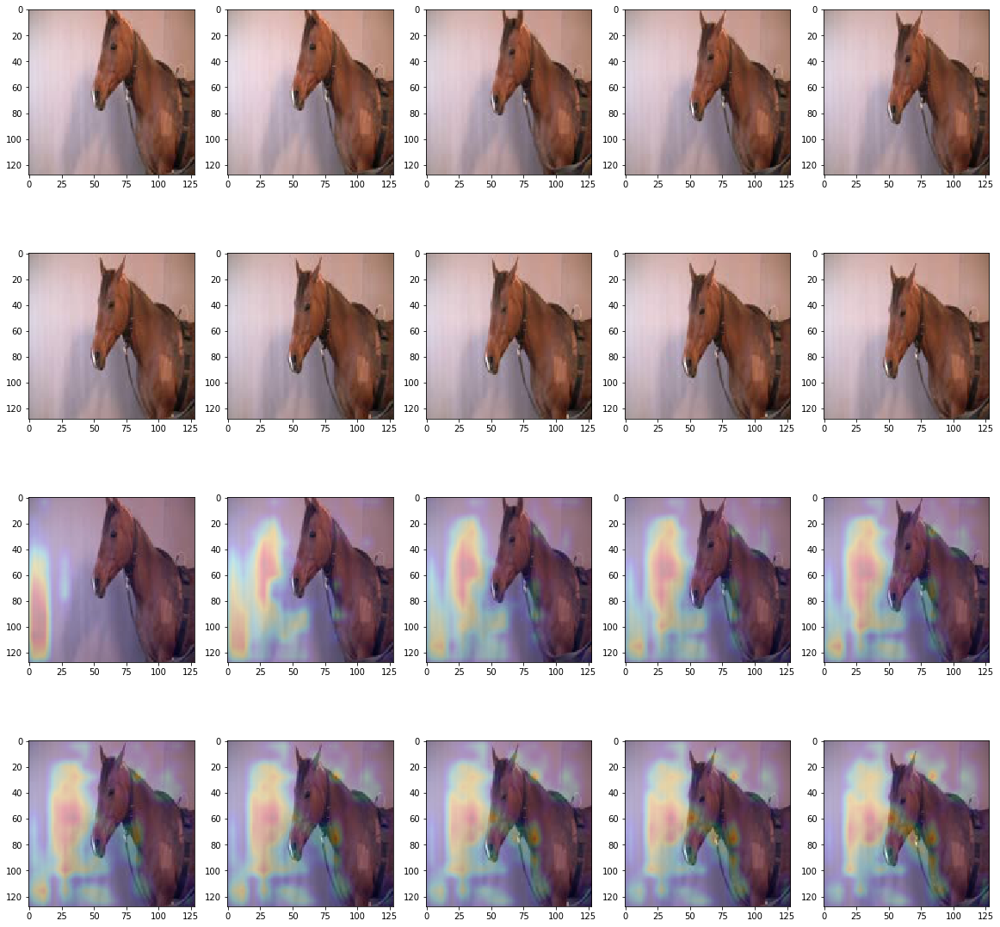

[ 0.66944605  0.32769194]
[ 0.66515642  0.36557907]
[ 0.53943586  0.58612013]
[ 0.33805996  0.79737234]
[ 0.20410544  0.89303339]
[ 0.14530368  0.94853723]
[ 0.12193459  0.97470278]
[ 0.11744729  0.98098135]
[ 0.10668821  0.98615438]
[ 0.07554537  0.98525745]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [47]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.62900025  0.33460832]
  [ 0.55026221  0.38727009]
  [ 0.36498222  0.63866848]
  [ 0.19035071  0.828179  ]
  [ 0.10782672  0.91546106]
  [ 0.07537589  0.95091456]
  [ 0.06065914  0.97014064]
  [ 0.04604088  0.97969627]
  [ 0.03455891  0.98368764]
  [ 0.02822738  0.98426163]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


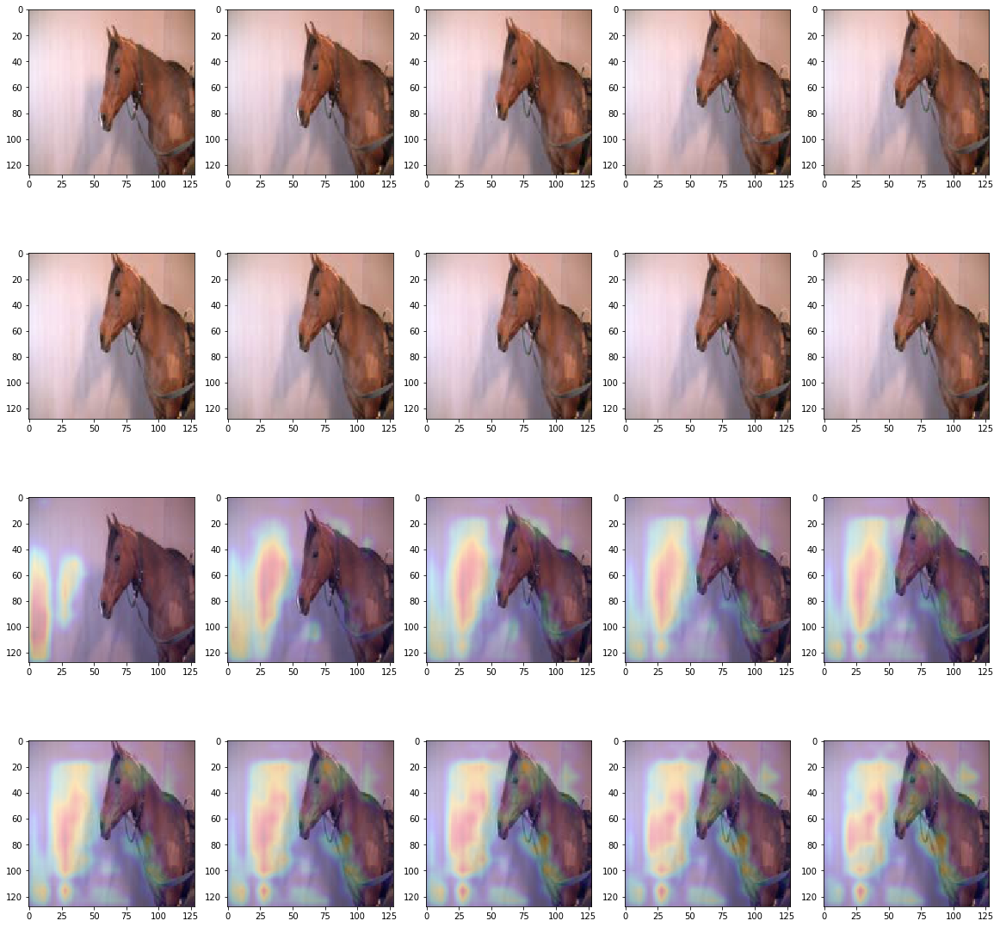

[ 0.62900025  0.33460832]
[ 0.55026221  0.38727009]
[ 0.36498222  0.63866848]
[ 0.19035071  0.828179  ]
[ 0.10782672  0.91546106]
[ 0.07537589  0.95091456]
[ 0.06065914  0.97014064]
[ 0.04604088  0.97969627]
[ 0.03455891  0.98368764]
[ 0.02822738  0.98426163]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [48]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.65483499  0.37142077]
  [ 0.64193696  0.47177985]
  [ 0.47652748  0.64961517]
  [ 0.32482171  0.76155829]
  [ 0.2946727   0.80685937]
  [ 0.28778523  0.79233789]
  [ 0.31785166  0.75034475]
  [ 0.34791458  0.70025378]
  [ 0.39334959  0.62228358]
  [ 0.43611357  0.57538027]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


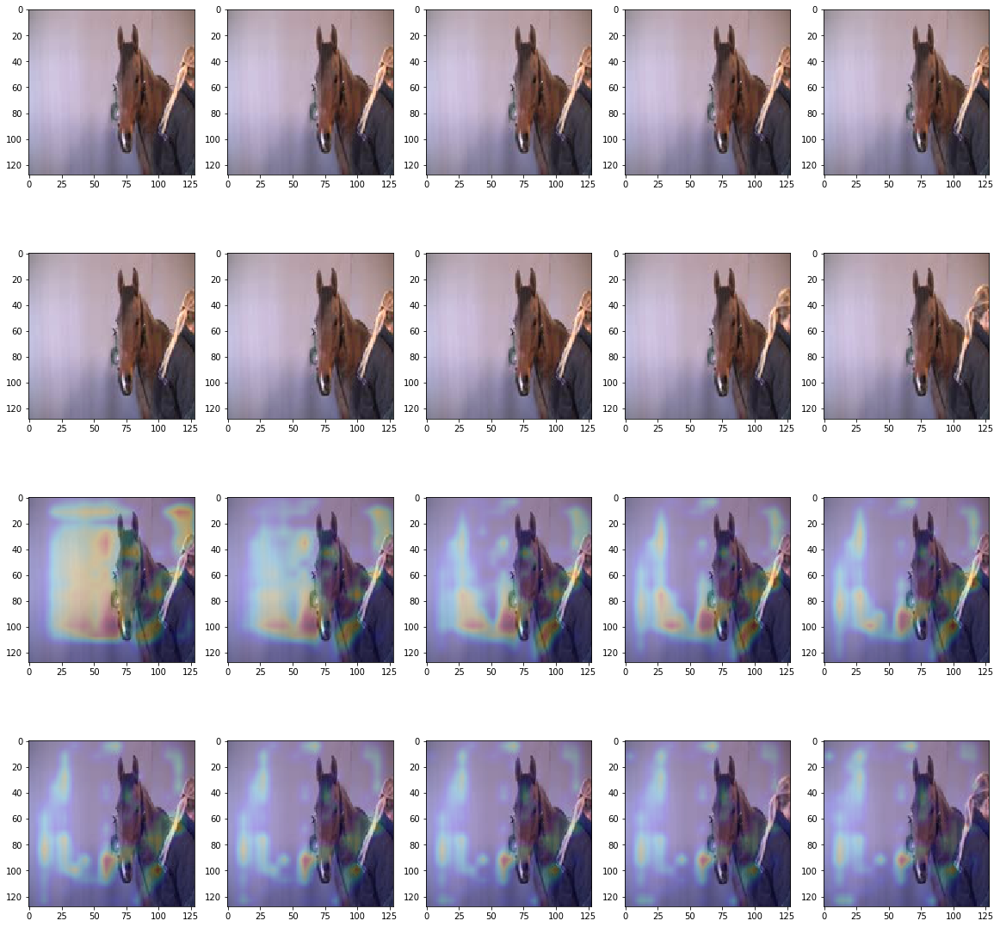

[ 0.65483499  0.37142077]
[ 0.64193696  0.47177985]
[ 0.47652748  0.64961517]
[ 0.32482171  0.76155829]
[ 0.2946727   0.80685937]
[ 0.28778523  0.79233789]
[ 0.31785166  0.75034475]
[ 0.34791458  0.70025378]
[ 0.39334959  0.62228358]
[ 0.43611357  0.57538027]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [49]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.63461667  0.33488229]
  [ 0.62146705  0.34333619]
  [ 0.57273495  0.38496953]
  [ 0.53504896  0.36524877]
  [ 0.54779392  0.31224233]
  [ 0.55548364  0.24173893]
  [ 0.52834904  0.17752862]
  [ 0.51789623  0.13431187]
  [ 0.53283155  0.09492223]
  [ 0.51483285  0.07804074]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


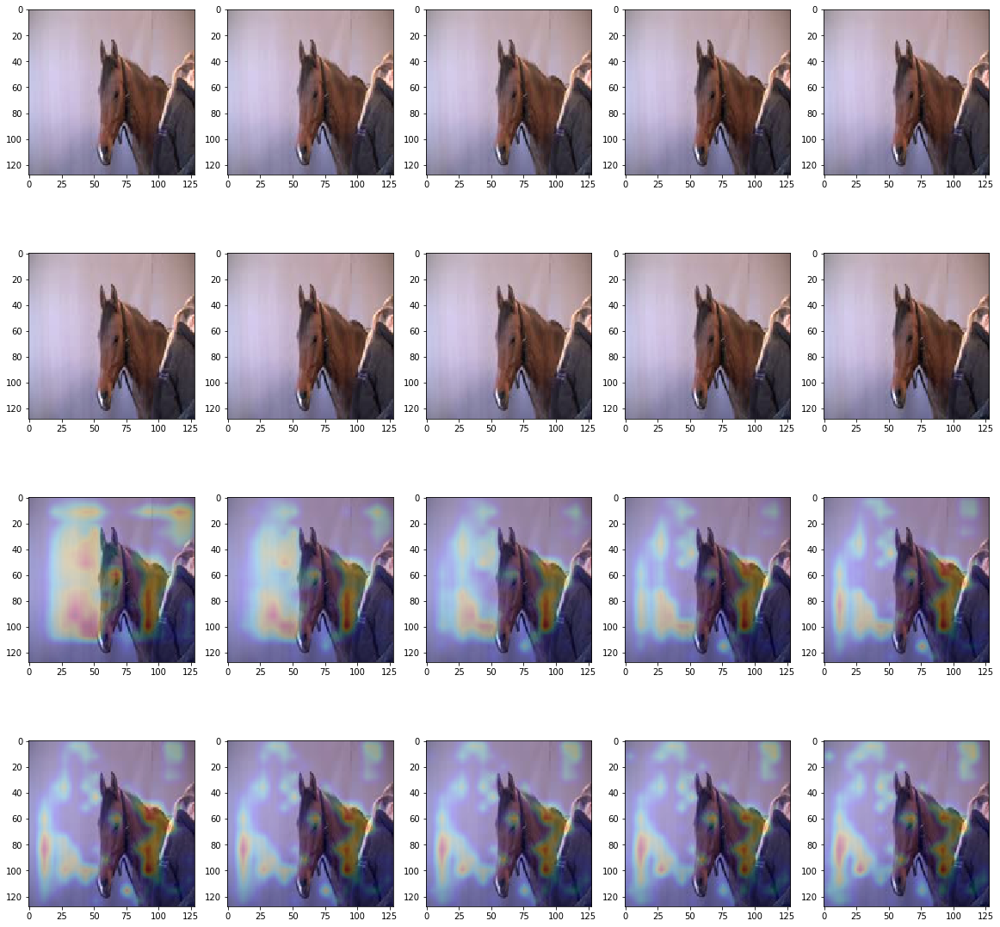

[ 0.63461667  0.33488229]
[ 0.62146705  0.34333619]
[ 0.57273495  0.38496953]
[ 0.53504896  0.36524877]
[ 0.54779392  0.31224233]
[ 0.55548364  0.24173893]
[ 0.52834904  0.17752862]
[ 0.51789623  0.13431187]
[ 0.53283155  0.09492223]
[ 0.51483285  0.07804074]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [50]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.748456    0.23990701]
  [ 0.8938145   0.08846889]
  [ 0.96540856  0.03552641]
  [ 0.98821568  0.02050382]
  [ 0.99339116  0.01722125]
  [ 0.99565315  0.0179803 ]
  [ 0.99725682  0.01967107]
  [ 0.99793291  0.02325318]
  [ 0.99812287  0.0263826 ]
  [ 0.99817014  0.03004798]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


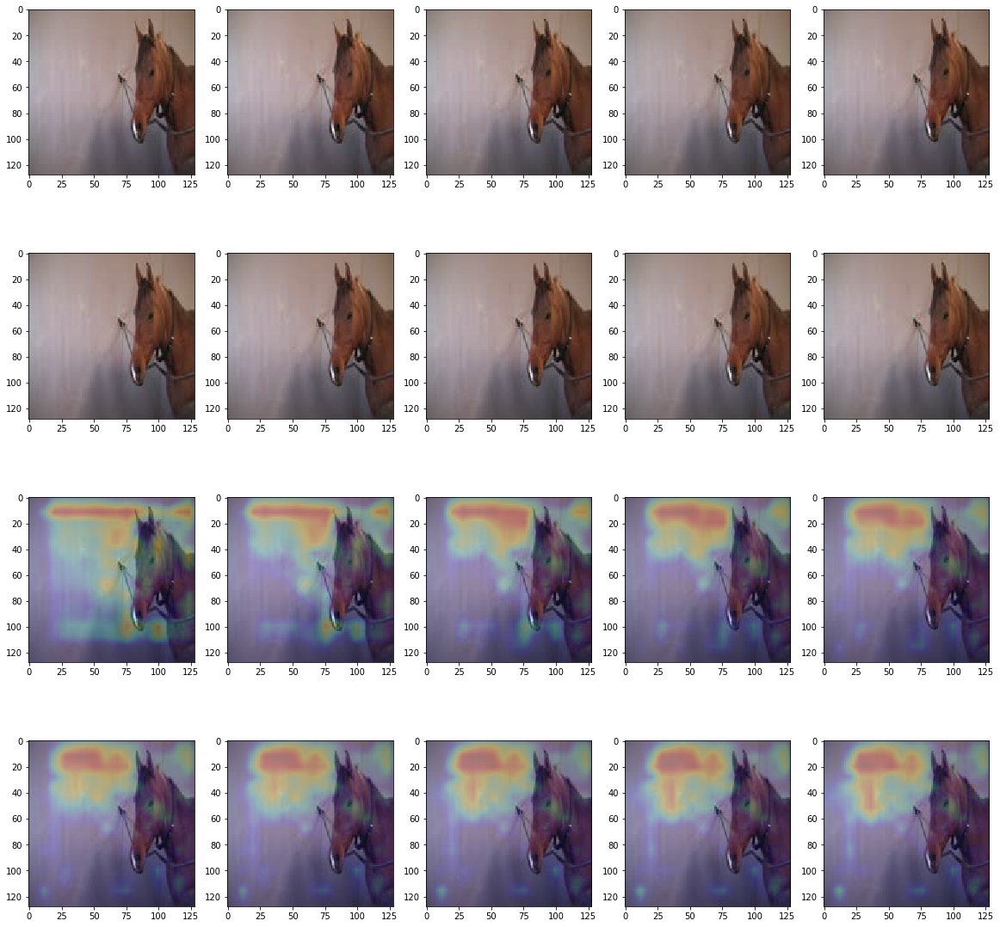

[ 0.748456    0.23990701]
[ 0.8938145   0.08846889]
[ 0.96540856  0.03552641]
[ 0.98821568  0.02050382]
[ 0.99339116  0.01722125]
[ 0.99565315  0.0179803 ]
[ 0.99725682  0.01967107]
[ 0.99793291  0.02325318]
[ 0.99812287  0.0263826 ]
[ 0.99817014  0.03004798]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [51]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[  7.51562178e-01   1.89346045e-01]
  [  8.90838087e-01   3.89116295e-02]
  [  9.55186129e-01   1.01076104e-02]
  [  9.81625915e-01   3.61916027e-03]
  [  9.90064681e-01   1.96238514e-03]
  [  9.94261861e-01   1.22597837e-03]
  [  9.96924222e-01   9.32914671e-04]
  [  9.97803152e-01   7.13508693e-04]
  [  9.98538017e-01   6.33067219e-04]
  [  9.98836339e-01   7.81710201e-04]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


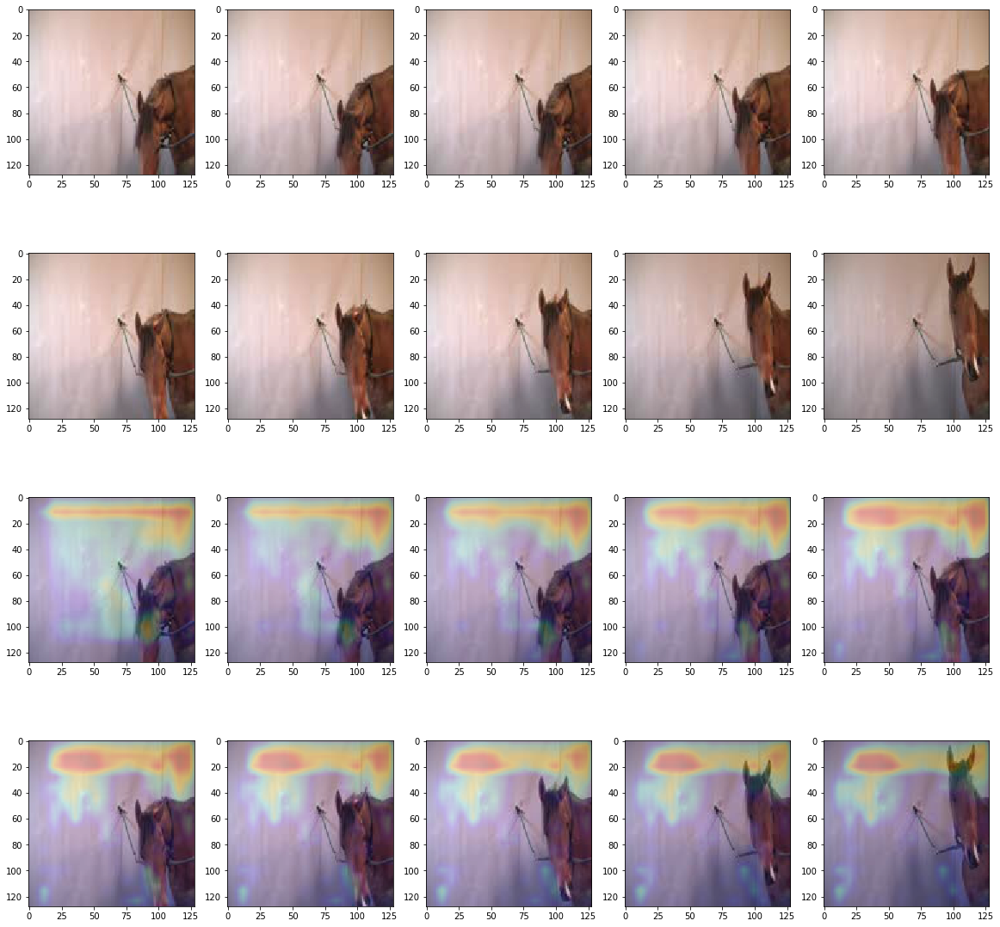

[ 0.75156218  0.18934605]
[ 0.89083809  0.03891163]
[ 0.95518613  0.01010761]
[ 0.98162591  0.00361916]
[ 0.99006468  0.00196239]
[ 0.99426186  0.00122598]
[  9.96924222e-01   9.32914671e-04]
[  9.97803152e-01   7.13508693e-04]
[  9.98538017e-01   6.33067219e-04]
[  9.98836339e-01   7.81710201e-04]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [52]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69773936  0.31832105]
  [ 0.78504157  0.30174196]
  [ 0.77426559  0.37501726]
  [ 0.69438154  0.46012032]
  [ 0.60587496  0.48149666]
  [ 0.50445169  0.47230697]
  [ 0.43976933  0.44292846]
  [ 0.40296888  0.41159609]
  [ 0.37957945  0.43579331]
  [ 0.33838141  0.47029063]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


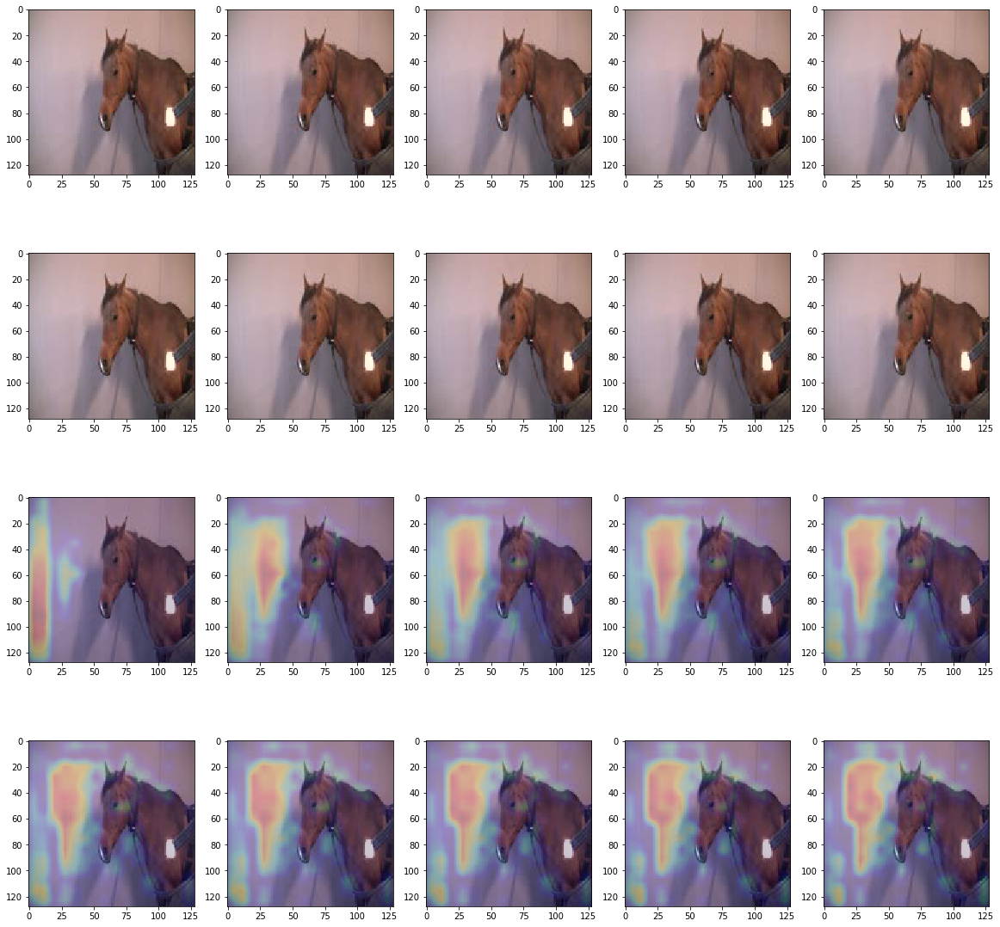

[ 0.69773936  0.31832105]
[ 0.78504157  0.30174196]
[ 0.77426559  0.37501726]
[ 0.69438154  0.46012032]
[ 0.60587496  0.48149666]
[ 0.50445169  0.47230697]
[ 0.43976933  0.44292846]
[ 0.40296888  0.41159609]
[ 0.37957945  0.43579331]
[ 0.33838141  0.47029063]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [53]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.67764831  0.33491996]
  [ 0.72357178  0.36185923]
  [ 0.68613899  0.47186181]
  [ 0.56986398  0.54764295]
  [ 0.46133596  0.51811004]
  [ 0.3781949   0.43570694]
  [ 0.31624272  0.37950599]
  [ 0.27566159  0.3533999 ]
  [ 0.24338786  0.34688866]
  [ 0.20652927  0.36443028]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


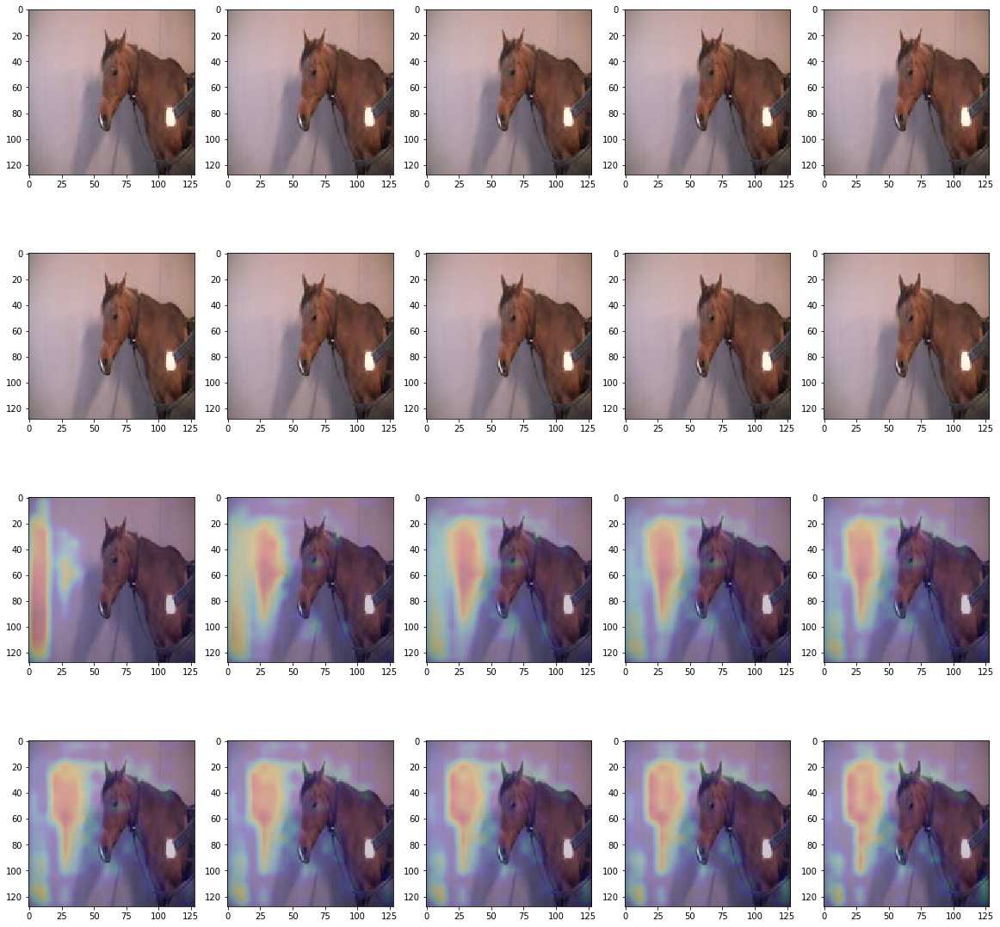

[ 0.67764831  0.33491996]
[ 0.72357178  0.36185923]
[ 0.68613899  0.47186181]
[ 0.56986398  0.54764295]
[ 0.46133596  0.51811004]
[ 0.3781949   0.43570694]
[ 0.31624272  0.37950599]
[ 0.27566159  0.3533999 ]
[ 0.24338786  0.34688866]
[ 0.20652927  0.36443028]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [54]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.54949623  0.42695826]
  [ 0.33387515  0.56900501]
  [ 0.12984604  0.77012378]
  [ 0.05151249  0.87691981]
  [ 0.02229491  0.91966021]
  [ 0.01490743  0.93625814]
  [ 0.01067917  0.94202536]
  [ 0.00963215  0.935646  ]
  [ 0.00986121  0.92523754]
  [ 0.01027345  0.91586876]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


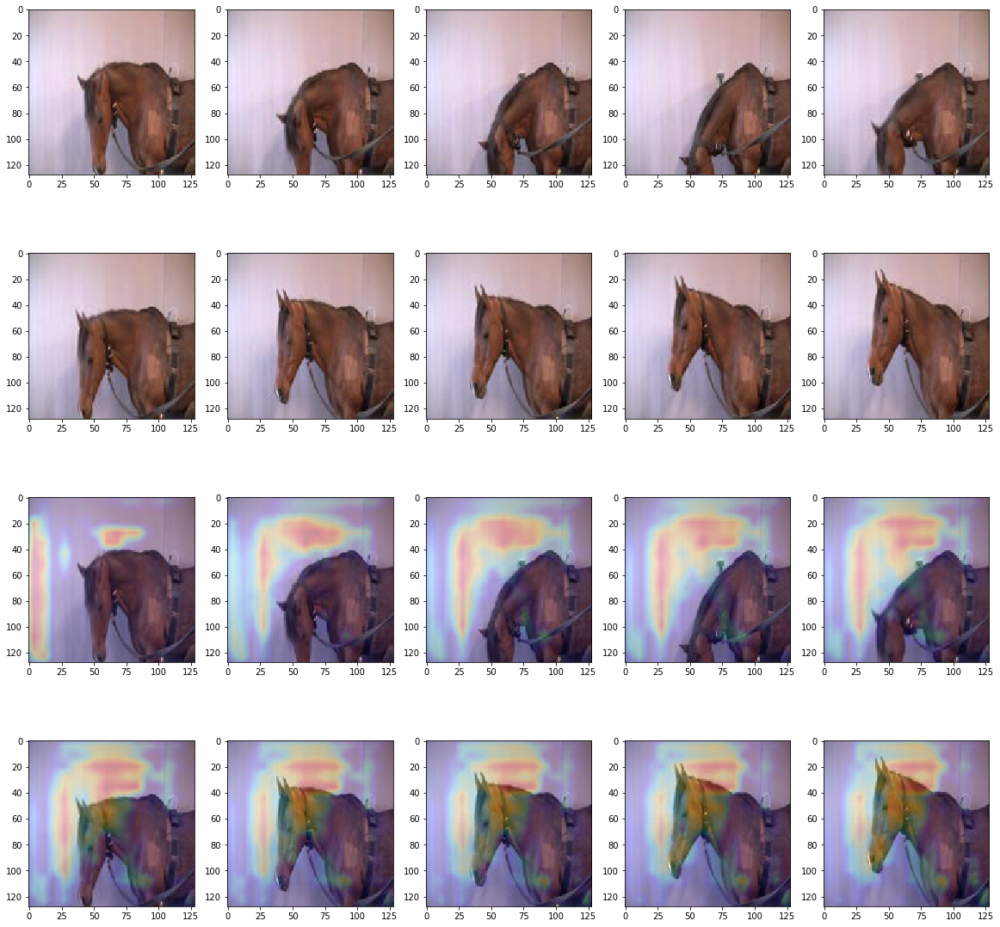

[ 0.54949623  0.42695826]
[ 0.33387515  0.56900501]
[ 0.12984604  0.77012378]
[ 0.05151249  0.87691981]
[ 0.02229491  0.91966021]
[ 0.01490743  0.93625814]
[ 0.01067917  0.94202536]
[ 0.00963215  0.935646  ]
[ 0.00986121  0.92523754]
[ 0.01027345  0.91586876]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [55]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.65932012  0.29977387]
  [ 0.67324841  0.22400664]
  [ 0.68603235  0.16824417]
  [ 0.72023875  0.10445625]
  [ 0.77691609  0.05761227]
  [ 0.82404405  0.03284774]
  [ 0.86846054  0.02285601]
  [ 0.89431238  0.0187759 ]
  [ 0.91489547  0.0160956 ]
  [ 0.92283583  0.01583284]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


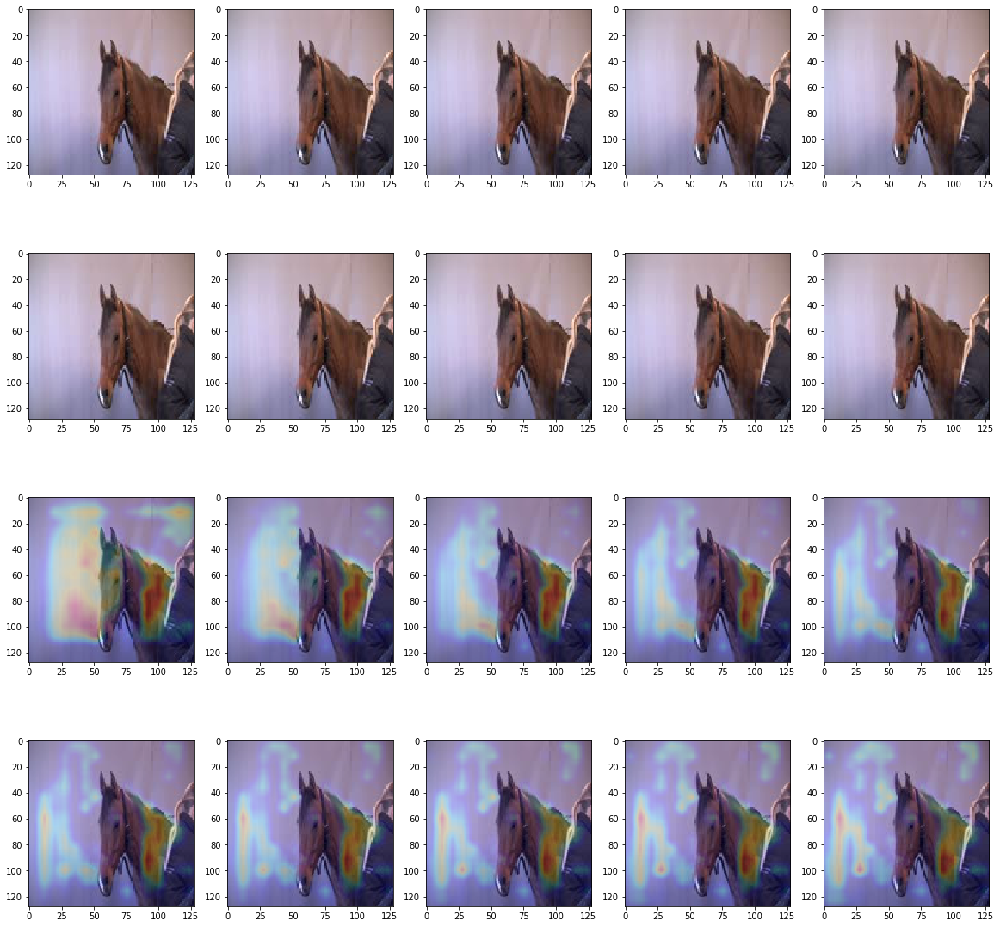

[ 0.65932012  0.29977387]
[ 0.67324841  0.22400664]
[ 0.68603235  0.16824417]
[ 0.72023875  0.10445625]
[ 0.77691609  0.05761227]
[ 0.82404405  0.03284774]
[ 0.86846054  0.02285601]
[ 0.89431238  0.0187759 ]
[ 0.91489547  0.0160956 ]
[ 0.92283583  0.01583284]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [56]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69277233  0.21959534]
  [ 0.87536895  0.05312641]
  [ 0.95684296  0.0180253 ]
  [ 0.98130304  0.01212385]
  [ 0.98726559  0.01311154]
  [ 0.9890371   0.01437544]
  [ 0.9915154   0.01993081]
  [ 0.99261099  0.02508027]
  [ 0.9930951   0.02847536]
  [ 0.99364728  0.03208838]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


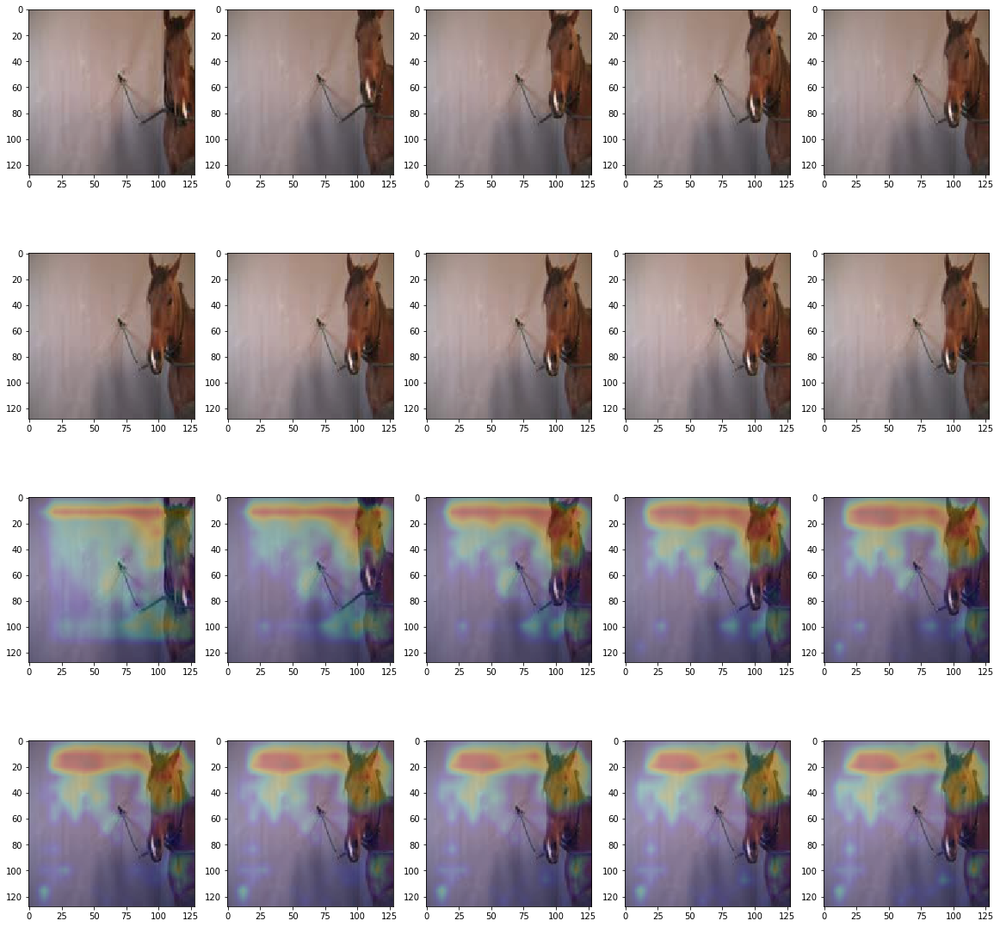

[ 0.69277233  0.21959534]
[ 0.87536895  0.05312641]
[ 0.95684296  0.0180253 ]
[ 0.98130304  0.01212385]
[ 0.98726559  0.01311154]
[ 0.9890371   0.01437544]
[ 0.9915154   0.01993081]
[ 0.99261099  0.02508027]
[ 0.9930951   0.02847536]
[ 0.99364728  0.03208838]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [57]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.64079618  0.2931183 ]
  [ 0.62622893  0.24716616]
  [ 0.59541023  0.23918548]
  [ 0.64174712  0.20494445]
  [ 0.72190052  0.14171232]
  [ 0.77219319  0.1003359 ]
  [ 0.78903449  0.06957861]
  [ 0.79568124  0.05656668]
  [ 0.80036485  0.04347507]
  [ 0.81303877  0.0370496 ]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


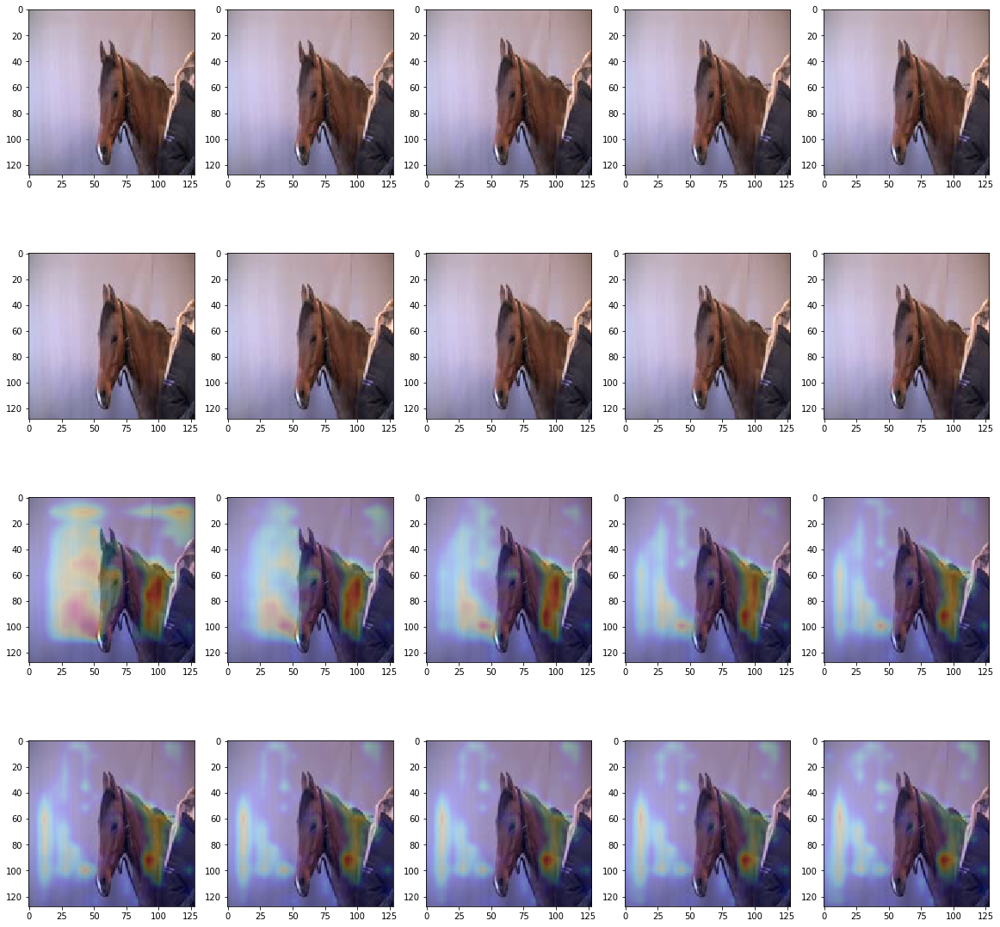

[ 0.64079618  0.2931183 ]
[ 0.62622893  0.24716616]
[ 0.59541023  0.23918548]
[ 0.64174712  0.20494445]
[ 0.72190052  0.14171232]
[ 0.77219319  0.1003359 ]
[ 0.78903449  0.06957861]
[ 0.79568124  0.05656668]
[ 0.80036485  0.04347507]
[ 0.81303877  0.0370496 ]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [58]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.75183743  0.29931256]
  [ 0.83530718  0.28201723]
  [ 0.8187958   0.38197446]
  [ 0.77053732  0.5286774 ]
  [ 0.7407853   0.60599703]
  [ 0.71464288  0.60063726]
  [ 0.69035733  0.54490787]
  [ 0.64986658  0.51115811]
  [ 0.59944642  0.48826379]
  [ 0.55306172  0.42448267]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


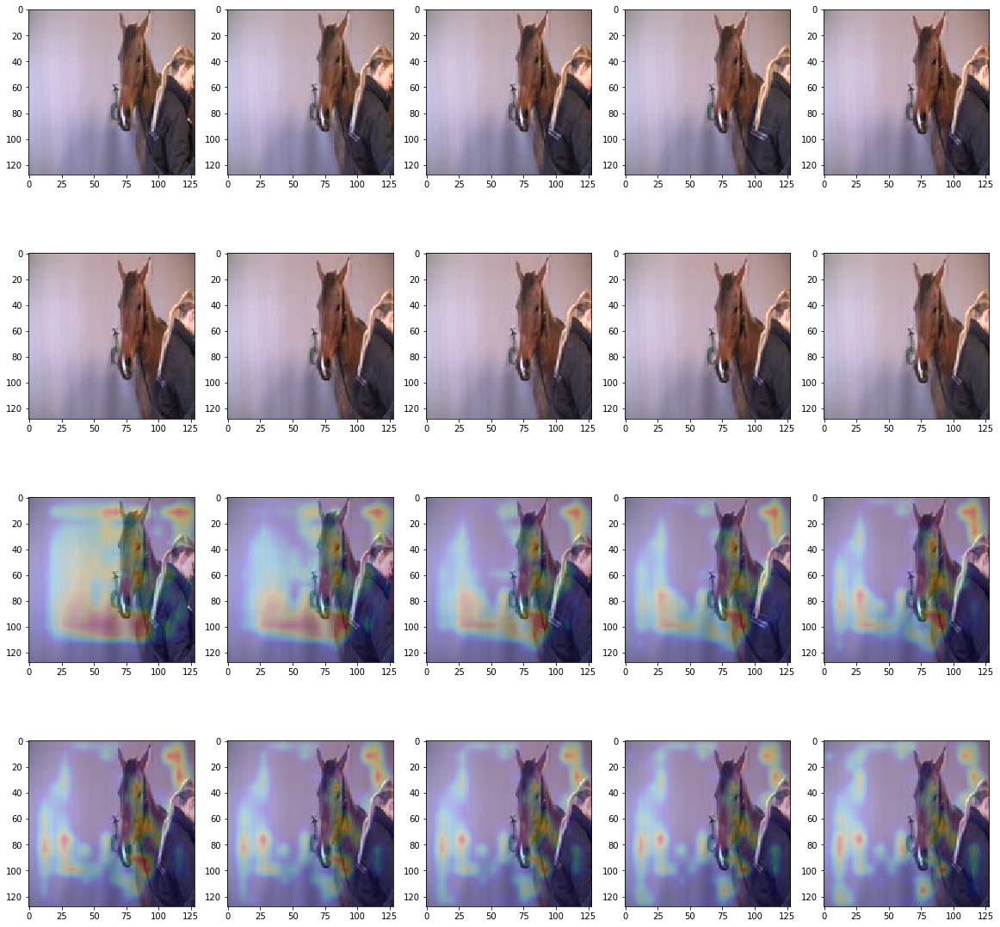

[ 0.75183743  0.29931256]
[ 0.83530718  0.28201723]
[ 0.8187958   0.38197446]
[ 0.77053732  0.5286774 ]
[ 0.7407853   0.60599703]
[ 0.71464288  0.60063726]
[ 0.69035733  0.54490787]
[ 0.64986658  0.51115811]
[ 0.59944642  0.48826379]
[ 0.55306172  0.42448267]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [59]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.75221944  0.20503162]
  [ 0.90671921  0.06765591]
  [ 0.965433    0.02615164]
  [ 0.98717749  0.01171971]
  [ 0.99460512  0.00807155]
  [ 0.99782348  0.00881132]
  [ 0.99893218  0.01119294]
  [ 0.99924743  0.0127599 ]
  [ 0.99933726  0.0129812 ]
  [ 0.99924588  0.01420887]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


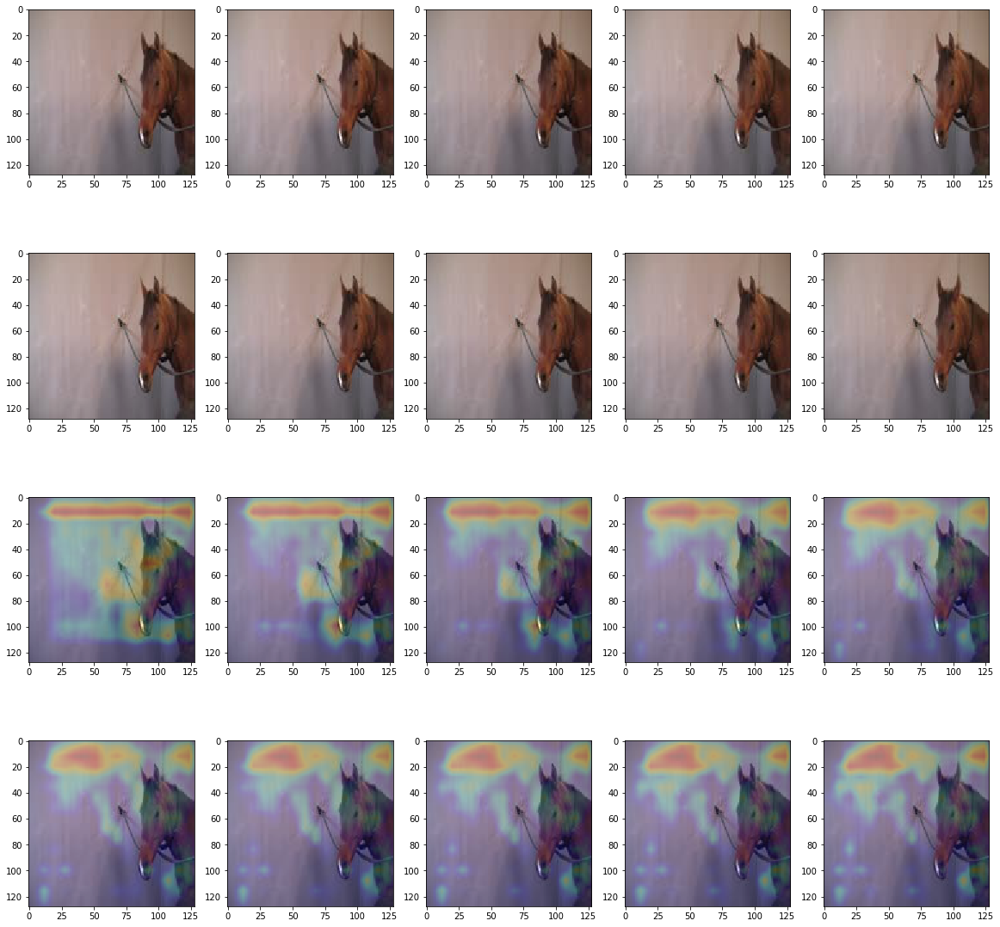

[ 0.75221944  0.20503162]
[ 0.90671921  0.06765591]
[ 0.965433    0.02615164]
[ 0.98717749  0.01171971]
[ 0.99460512  0.00807155]
[ 0.99782348  0.00881132]
[ 0.99893218  0.01119294]
[ 0.99924743  0.0127599 ]
[ 0.99933726  0.0129812 ]
[ 0.99924588  0.01420887]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [60]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.76512665  0.18444668]
  [ 0.91184449  0.04737021]
  [ 0.96280211  0.0176085 ]
  [ 0.98162526  0.01039909]
  [ 0.9894169   0.00835182]
  [ 0.99330312  0.00727501]
  [ 0.99535948  0.00693093]
  [ 0.99591786  0.0068228 ]
  [ 0.99596977  0.00696839]
  [ 0.99587858  0.00728425]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


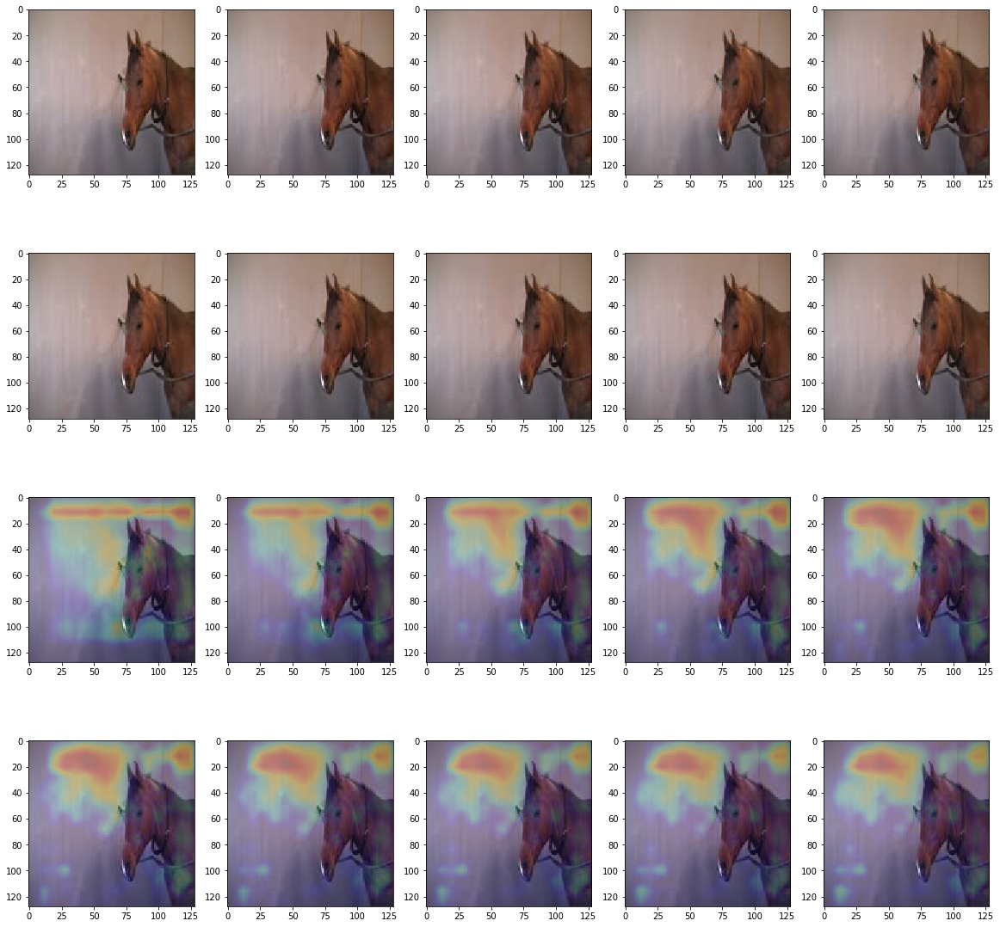

[ 0.76512665  0.18444668]
[ 0.91184449  0.04737021]
[ 0.96280211  0.0176085 ]
[ 0.98162526  0.01039909]
[ 0.9894169   0.00835182]
[ 0.99330312  0.00727501]
[ 0.99535948  0.00693093]
[ 0.99591786  0.0068228 ]
[ 0.99596977  0.00696839]
[ 0.99587858  0.00728425]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [61]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.66655725  0.355048  ]
  [ 0.66837448  0.36734205]
  [ 0.50529659  0.47688589]
  [ 0.2497429   0.58644652]
  [ 0.14631777  0.63221633]
  [ 0.1030537   0.61891747]
  [ 0.07838488  0.59001541]
  [ 0.07622929  0.57576334]
  [ 0.0895299   0.54625821]
  [ 0.10297658  0.50398356]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


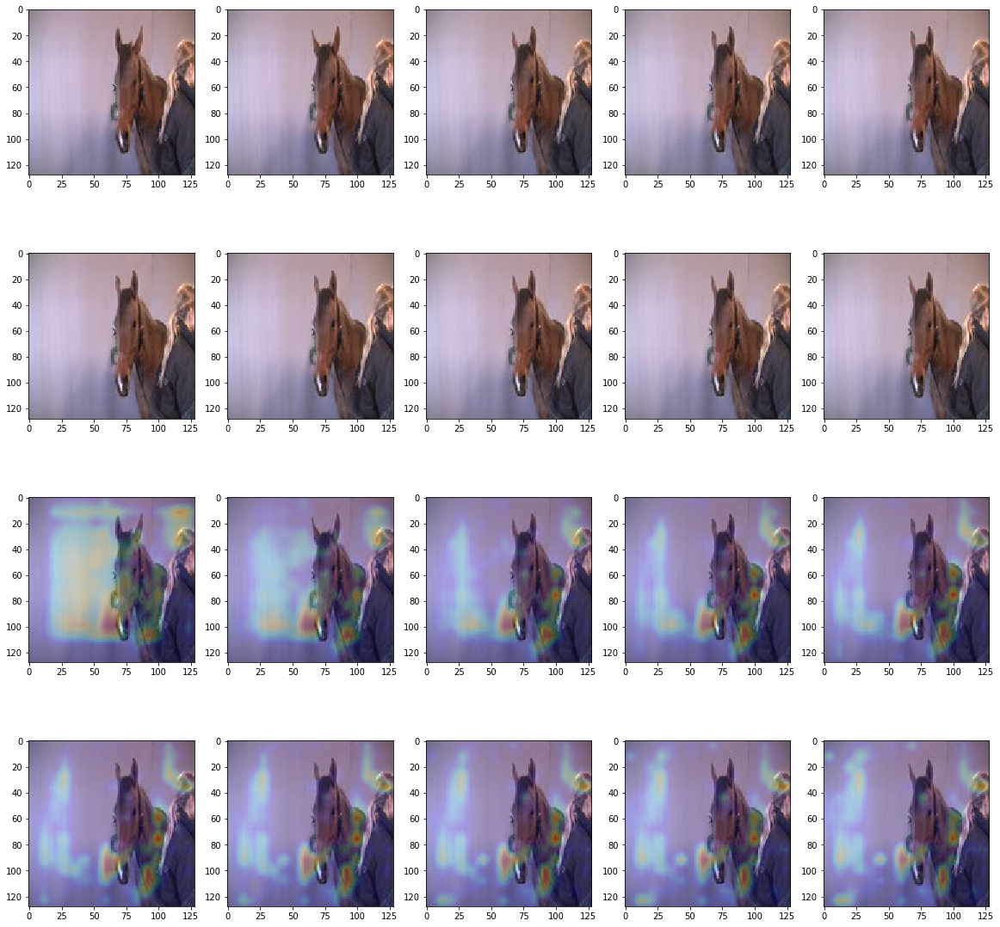

[ 0.66655725  0.355048  ]
[ 0.66837448  0.36734205]
[ 0.50529659  0.47688589]
[ 0.2497429   0.58644652]
[ 0.14631777  0.63221633]
[ 0.1030537   0.61891747]
[ 0.07838488  0.59001541]
[ 0.07622929  0.57576334]
[ 0.0895299   0.54625821]
[ 0.10297658  0.50398356]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [62]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.63664705  0.37629956]
  [ 0.61291933  0.52988905]
  [ 0.50776559  0.76818198]
  [ 0.32795823  0.88599932]
  [ 0.21256791  0.92648047]
  [ 0.1583603   0.92662966]
  [ 0.12306736  0.9086386 ]
  [ 0.10099702  0.88040686]
  [ 0.08797956  0.85365045]
  [ 0.08915301  0.83415908]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


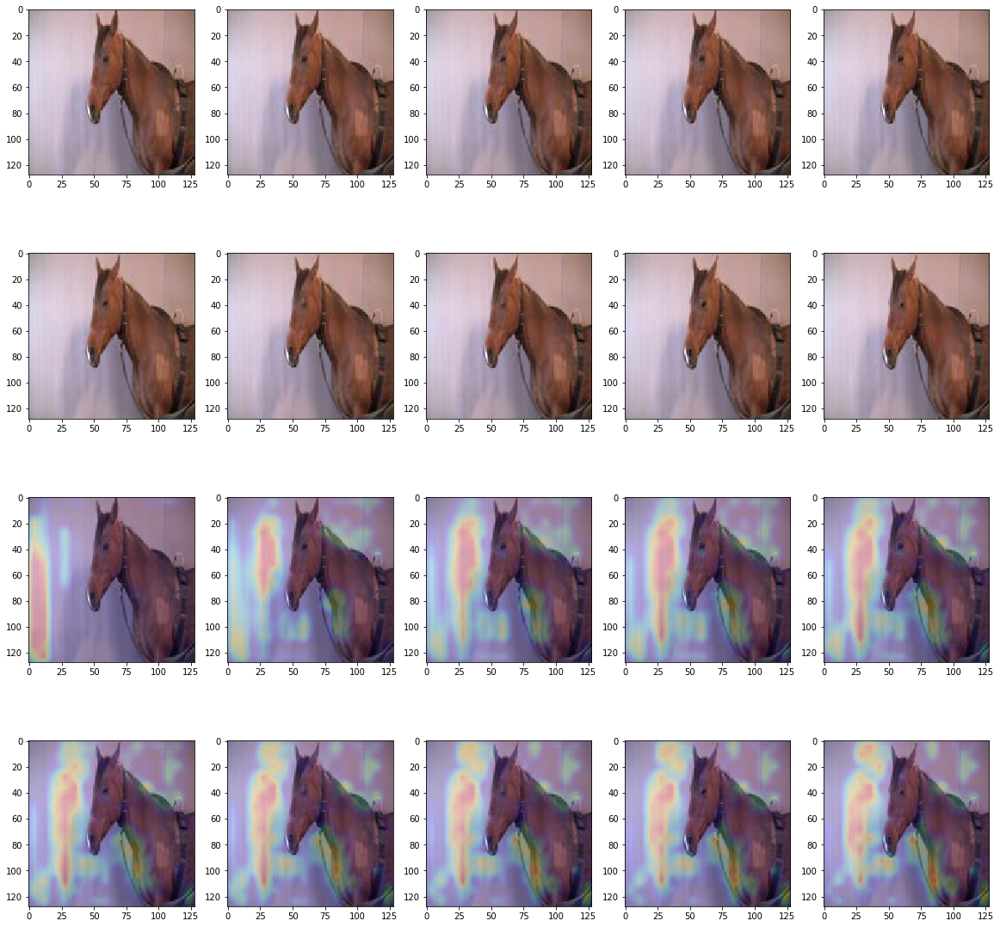

[ 0.63664705  0.37629956]
[ 0.61291933  0.52988905]
[ 0.50776559  0.76818198]
[ 0.32795823  0.88599932]
[ 0.21256791  0.92648047]
[ 0.1583603   0.92662966]
[ 0.12306736  0.9086386 ]
[ 0.10099702  0.88040686]
[ 0.08797956  0.85365045]
[ 0.08915301  0.83415908]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [63]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.60432208  0.37965983]
  [ 0.57370085  0.47877553]
  [ 0.48586175  0.6383937 ]
  [ 0.3337366   0.75506407]
  [ 0.22156337  0.82676488]
  [ 0.14944772  0.83160543]
  [ 0.12017456  0.80663002]
  [ 0.10048564  0.7792232 ]
  [ 0.09066354  0.7509985 ]
  [ 0.08916838  0.71960932]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


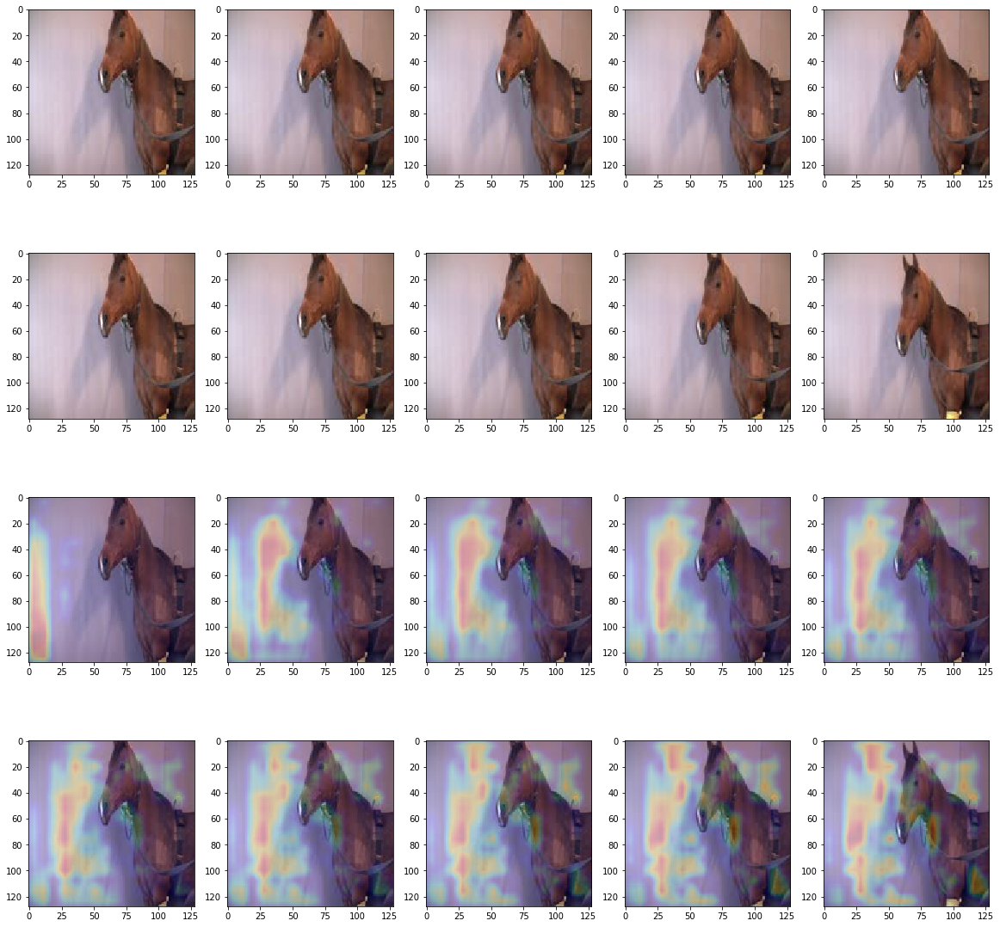

[ 0.60432208  0.37965983]
[ 0.57370085  0.47877553]
[ 0.48586175  0.6383937 ]
[ 0.3337366   0.75506407]
[ 0.22156337  0.82676488]
[ 0.14944772  0.83160543]
[ 0.12017456  0.80663002]
[ 0.10048564  0.7792232 ]
[ 0.09066354  0.7509985 ]
[ 0.08916838  0.71960932]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [64]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.75840813  0.20528859]
  [ 0.9142924   0.05588747]
  [ 0.97606307  0.0152624 ]
  [ 0.99136835  0.00671743]
  [ 0.99518532  0.00432173]
  [ 0.9967829   0.00358993]
  [ 0.99791807  0.00353655]
  [ 0.99857223  0.00309591]
  [ 0.99892288  0.00232873]
  [ 0.99907899  0.00180355]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


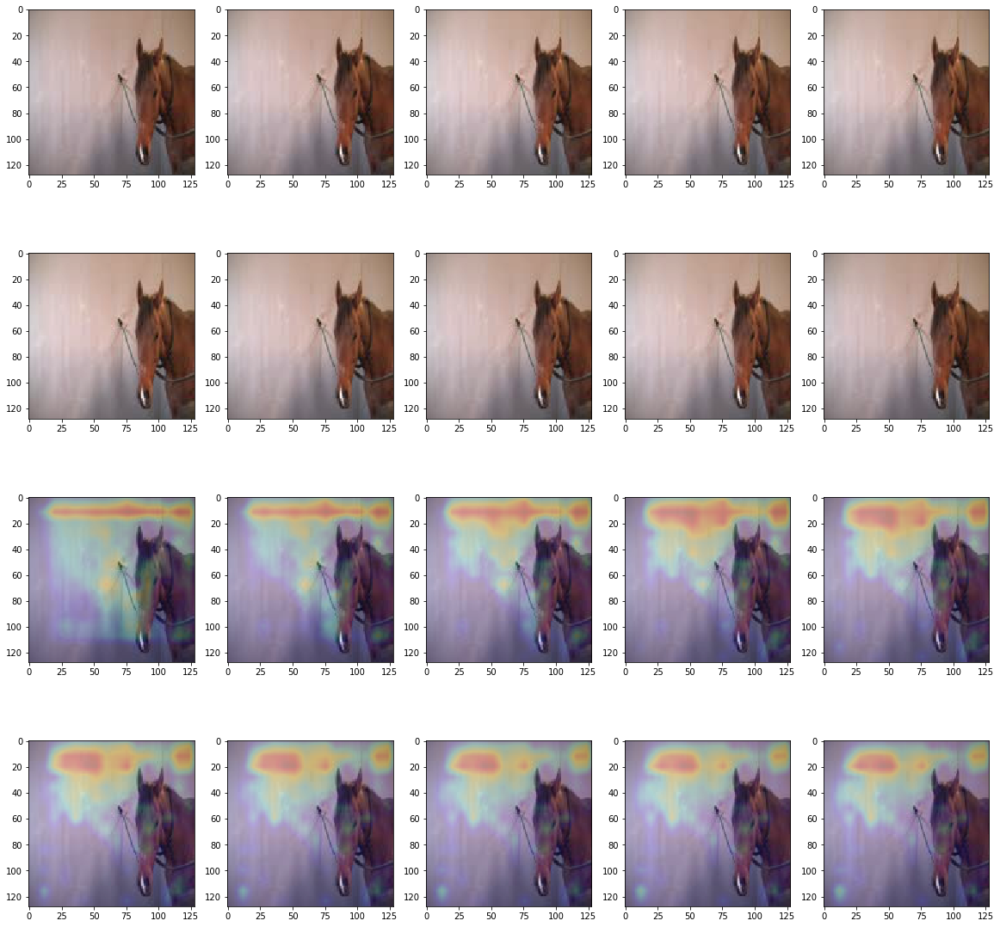

[ 0.75840813  0.20528859]
[ 0.9142924   0.05588747]
[ 0.97606307  0.0152624 ]
[ 0.99136835  0.00671743]
[ 0.99518532  0.00432173]
[ 0.9967829   0.00358993]
[ 0.99791807  0.00353655]
[ 0.99857223  0.00309591]
[ 0.99892288  0.00232873]
[ 0.99907899  0.00180355]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [65]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.70210868  0.27977923]
  [ 0.73619986  0.22911982]
  [ 0.67042822  0.24370724]
  [ 0.64831573  0.2304538 ]
  [ 0.66256851  0.1998156 ]
  [ 0.71927983  0.16169997]
  [ 0.74918252  0.12781528]
  [ 0.76845372  0.1120278 ]
  [ 0.75926644  0.11336834]
  [ 0.75729752  0.13159253]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


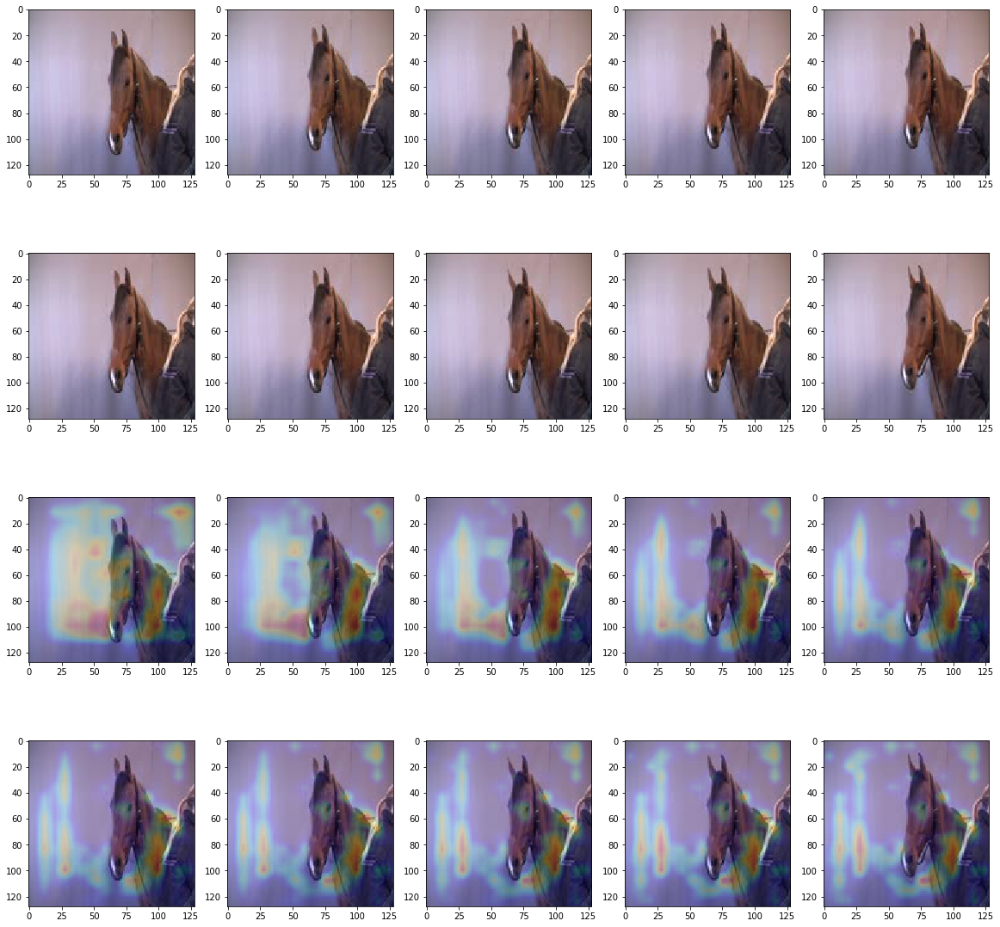

[ 0.70210868  0.27977923]
[ 0.73619986  0.22911982]
[ 0.67042822  0.24370724]
[ 0.64831573  0.2304538 ]
[ 0.66256851  0.1998156 ]
[ 0.71927983  0.16169997]
[ 0.74918252  0.12781528]
[ 0.76845372  0.1120278 ]
[ 0.75926644  0.11336834]
[ 0.75729752  0.13159253]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [66]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.69556797  0.28131872]
  [ 0.69603366  0.26812816]
  [ 0.57702893  0.38570023]
  [ 0.44636554  0.63211679]
  [ 0.31461418  0.83570176]
  [ 0.27068692  0.92040998]
  [ 0.23217832  0.9579224 ]
  [ 0.17301594  0.96479005]
  [ 0.10628294  0.96588737]
  [ 0.06611398  0.96592849]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


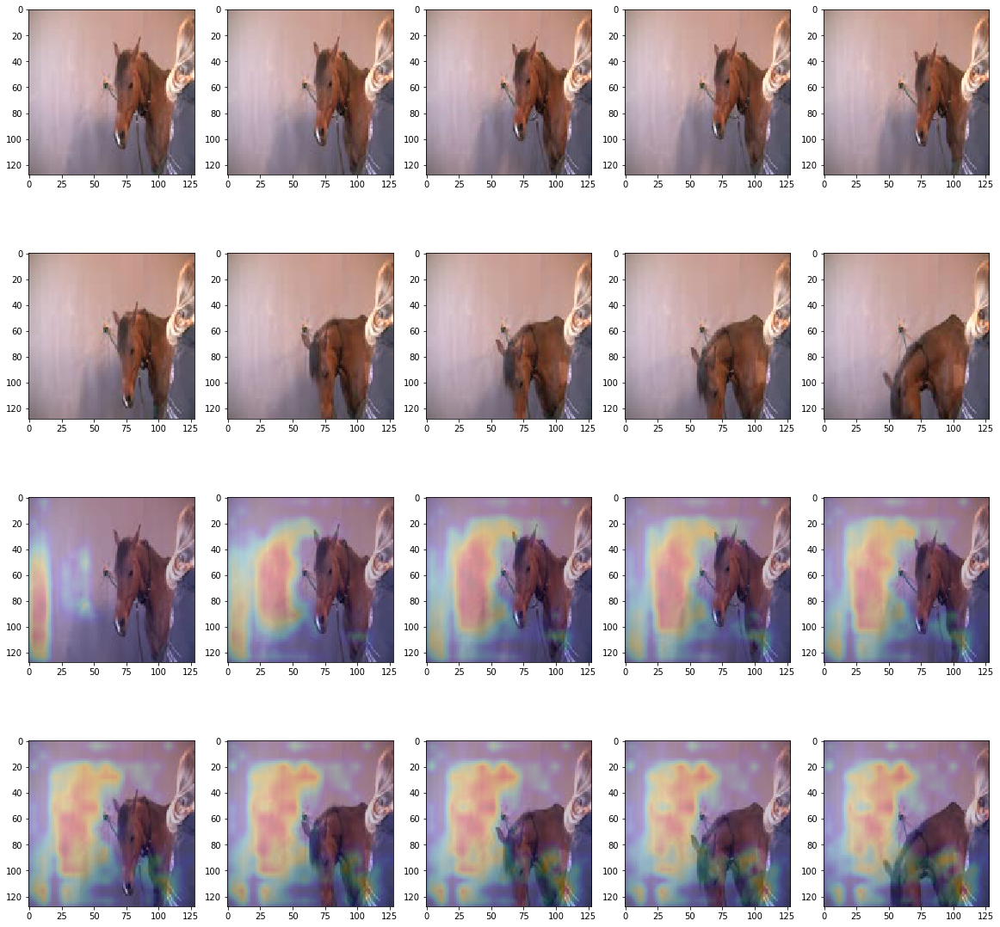

[ 0.69556797  0.28131872]
[ 0.69603366  0.26812816]
[ 0.57702893  0.38570023]
[ 0.44636554  0.63211679]
[ 0.31461418  0.83570176]
[ 0.27068692  0.92040998]
[ 0.23217832  0.9579224 ]
[ 0.17301594  0.96479005]
[ 0.10628294  0.96588737]
[ 0.06611398  0.96592849]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [67]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.74056637  0.21052411]
  [ 0.89891553  0.06196329]
  [ 0.96317381  0.01898012]
  [ 0.98226041  0.00824608]
  [ 0.98801643  0.00561856]
  [ 0.98904687  0.0045876 ]
  [ 0.98988146  0.00515883]
  [ 0.99029541  0.00575878]
  [ 0.99237204  0.00536659]
  [ 0.99296957  0.00504965]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


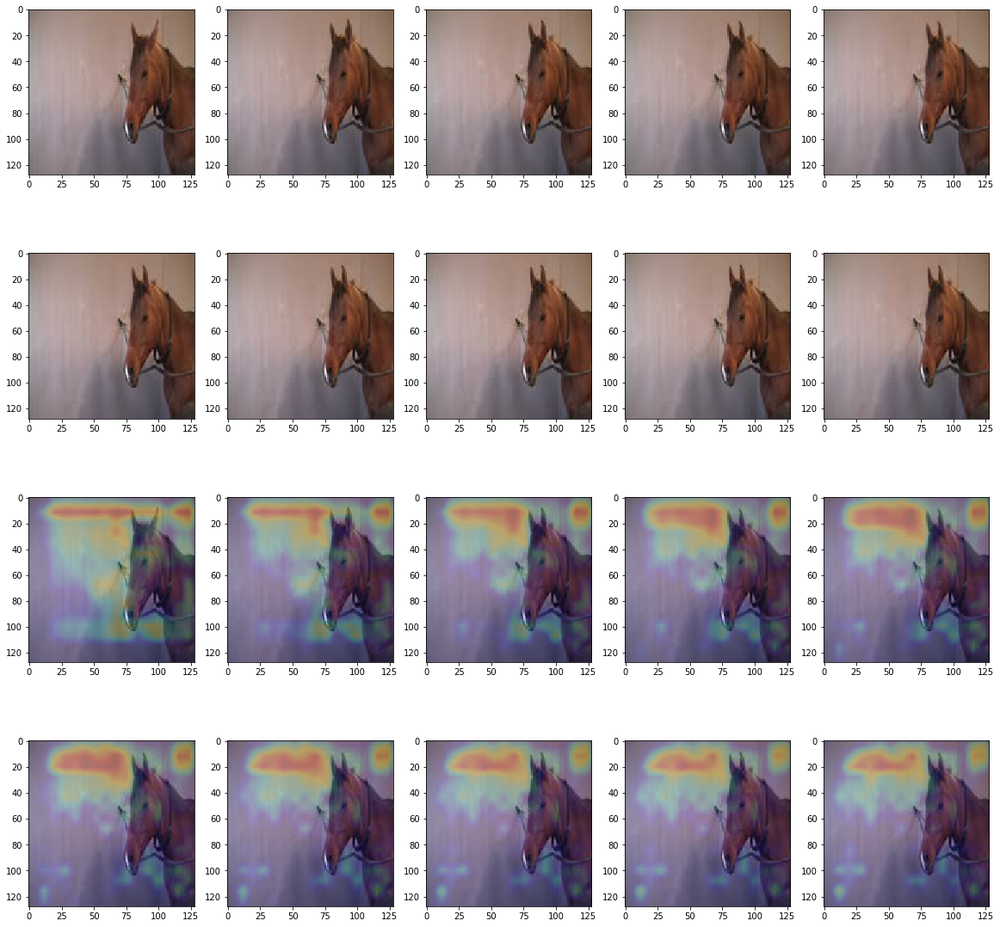

[ 0.74056637  0.21052411]
[ 0.89891553  0.06196329]
[ 0.96317381  0.01898012]
[ 0.98226041  0.00824608]
[ 0.98801643  0.00561856]
[ 0.98904687  0.0045876 ]
[ 0.98988146  0.00515883]
[ 0.99029541  0.00575878]
[ 0.99237204  0.00536659]
[ 0.99296957  0.00504965]
[[[ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]
  [ 1.  0.]]]


In [68]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(4)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.41612852  0.51847798]
  [ 0.12298916  0.85481566]
  [ 0.02742805  0.97312117]
  [ 0.01170685  0.98916477]
  [ 0.00701734  0.99136835]
  [ 0.00642907  0.99107474]
  [ 0.00709387  0.98863935]
  [ 0.00857512  0.98585331]
  [ 0.01206225  0.97870559]
  [ 0.01716227  0.97008485]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


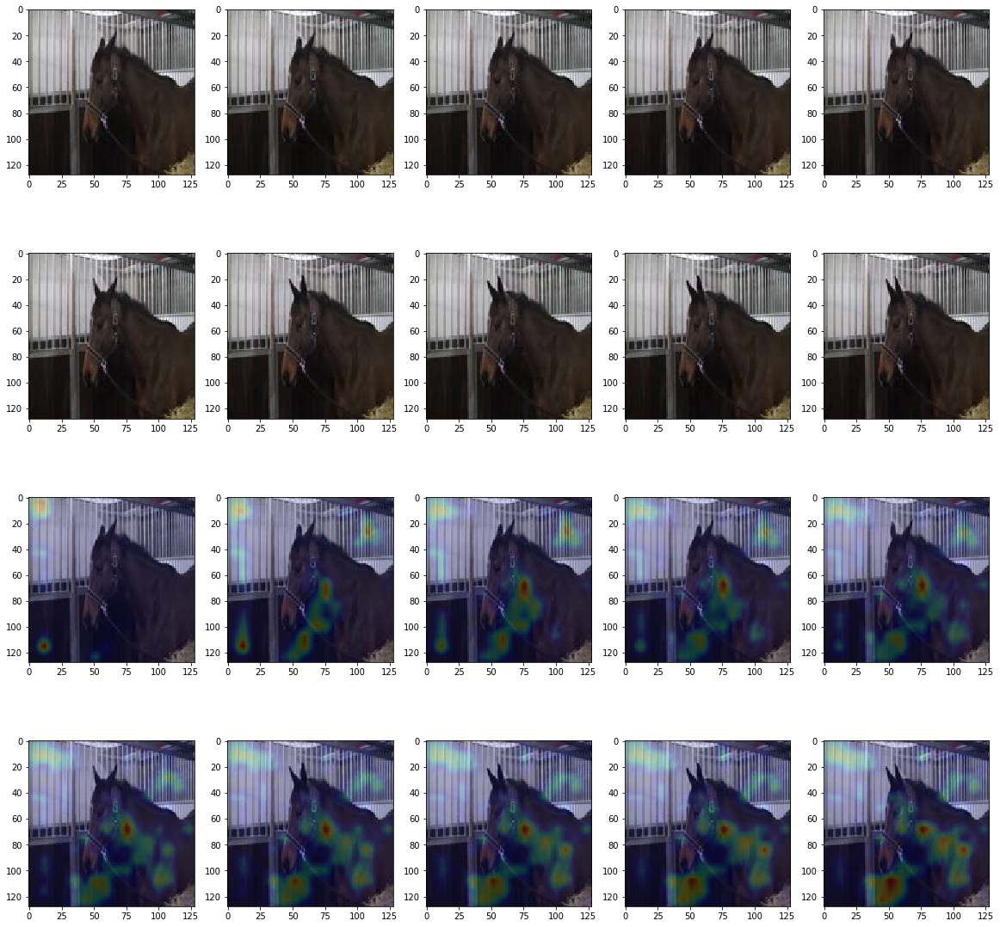

[ 0.41612852  0.51847798]
[ 0.12298916  0.85481566]
[ 0.02742805  0.97312117]
[ 0.01170685  0.98916477]
[ 0.00701734  0.99136835]
[ 0.00642907  0.99107474]
[ 0.00709387  0.98863935]
[ 0.00857512  0.98585331]
[ 0.01206225  0.97870559]
[ 0.01716227  0.97008485]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [69]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(1)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.39865619  0.5298503 ]
  [ 0.13051847  0.86598754]
  [ 0.05529762  0.97000164]
  [ 0.04444157  0.98476183]
  [ 0.05995915  0.98401469]
  [ 0.08991462  0.97760004]
  [ 0.13042435  0.9746635 ]
  [ 0.16444086  0.97404712]
  [ 0.20218982  0.97467357]
  [ 0.24764588  0.97483999]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


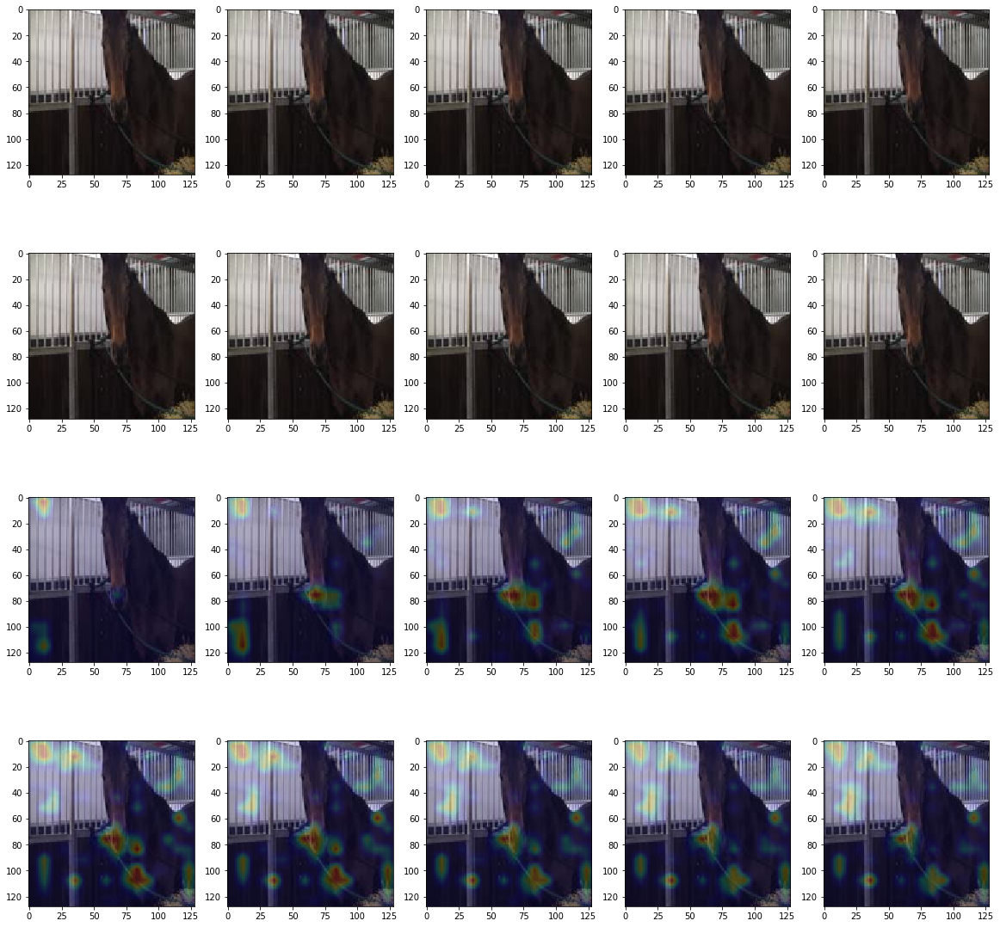

[ 0.39865619  0.5298503 ]
[ 0.13051847  0.86598754]
[ 0.05529762  0.97000164]
[ 0.04444157  0.98476183]
[ 0.05995915  0.98401469]
[ 0.08991462  0.97760004]
[ 0.13042435  0.9746635 ]
[ 0.16444086  0.97404712]
[ 0.20218982  0.97467357]
[ 0.24764588  0.97483999]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [70]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(0)
run_on_one_sequence(batch_img, batch_flow)

[[[ 0.58798534  0.45423919]
  [ 0.40329447  0.70824265]
  [ 0.15882994  0.92281604]
  [ 0.05154294  0.98027521]
  [ 0.02274344  0.99350995]
  [ 0.0165649   0.99685055]
  [ 0.01283628  0.99773383]
  [ 0.01242363  0.99803084]
  [ 0.01450622  0.99790418]
  [ 0.01758583  0.99732167]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


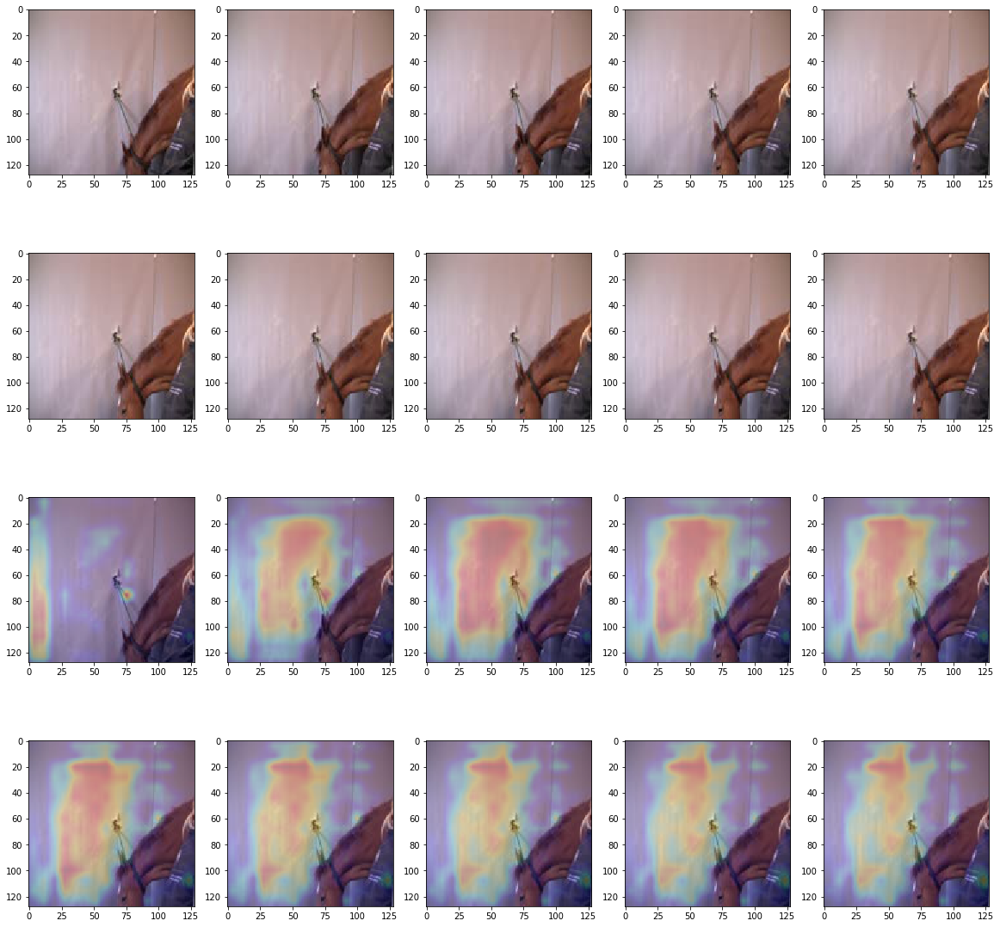

[ 0.58798534  0.45423919]
[ 0.40329447  0.70824265]
[ 0.15882994  0.92281604]
[ 0.05154294  0.98027521]
[ 0.02274344  0.99350995]
[ 0.0165649   0.99685055]
[ 0.01283628  0.99773383]
[ 0.01242363  0.99803084]
[ 0.01450622  0.99790418]
[ 0.01758583  0.99732167]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [71]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(2)
run_on_one_sequence(batch_img, batch_flow)

[[[  7.14493990e-01   3.63993943e-01]
  [  6.21592700e-01   5.35590947e-01]
  [  3.29142660e-01   7.97377050e-01]
  [  1.02366082e-01   9.22988296e-01]
  [  2.91382838e-02   9.72749591e-01]
  [  8.25125910e-03   9.89907980e-01]
  [  2.51256861e-03   9.95614886e-01]
  [  9.34790296e-04   9.98252213e-01]
  [  5.27386146e-04   9.99102592e-01]
  [  4.27813706e-04   9.99349892e-01]]]


/home/sbroome/miniconda3/envs/pfr_june/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


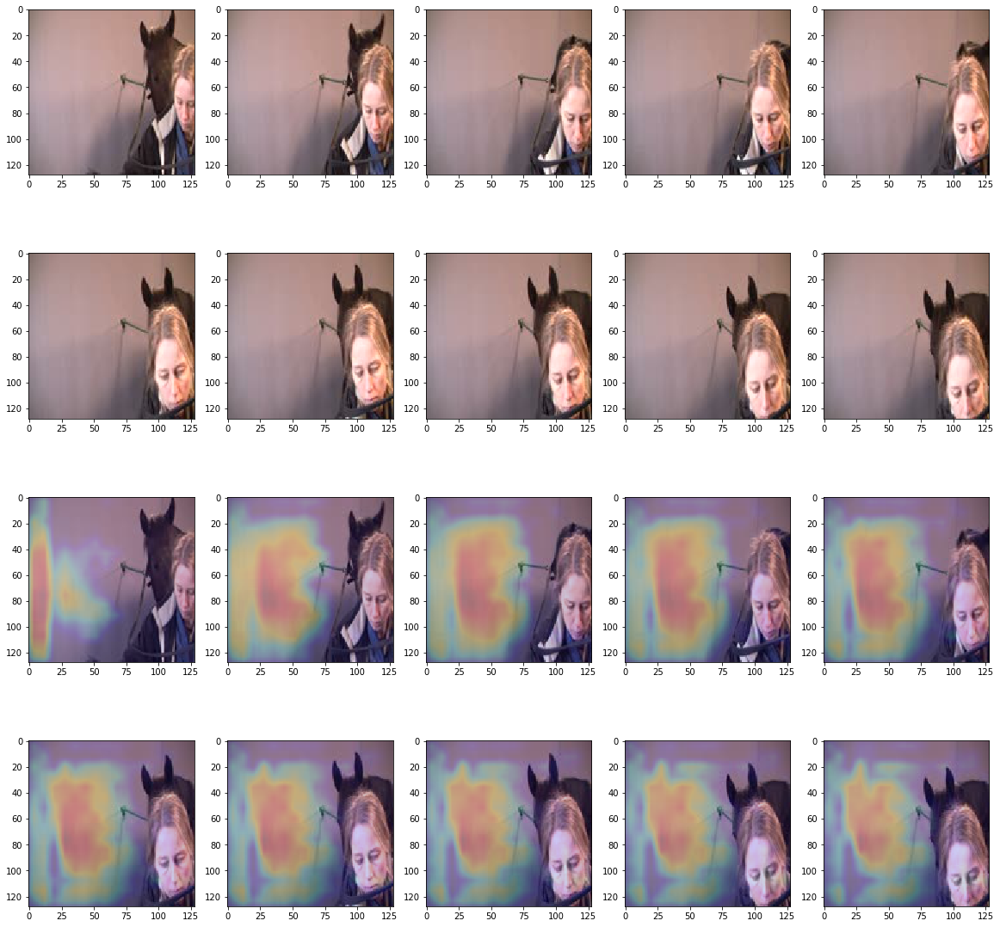

[ 0.71449399  0.36399394]
[ 0.6215927   0.53559095]
[ 0.32914266  0.79737705]
[ 0.10236608  0.9229883 ]
[ 0.02913828  0.97274959]
[ 0.00825126  0.98990798]
[ 0.00251257  0.99561489]
[  9.34790296e-04   9.98252213e-01]
[  5.27386146e-04   9.99102592e-01]
[  4.27813706e-04   9.99349892e-01]
[[[ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]
  [ 0.  1.]]]


In [72]:
batch_img, batch_flow, batch_label = data_for_one_random_sequence(5)
run_on_one_sequence(batch_img, batch_flow)